In [2]:
import numpy as np
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from gensim.models import FastText
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer
from imblearn.over_sampling import RandomOverSampler
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.neural_network import MLPClassifier
from sklearn.preprocessing import OneHotEncoder
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from gensim.utils import simple_preprocess
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import confusion_matrix
from joblib import dump, load
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import norm
import pickle
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import nltk
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger_eng')

[nltk_data] Downloading package punkt to C:\Users\pc
[nltk_data]     cam\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger_eng to
[nltk_data]     C:\Users\pc cam\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger_eng is already up-to-
[nltk_data]       date!


True

In [12]:
import scipy

In [2]:
print(scipy.__version__)

1.12.0


## A. Préparation de données 

<div class="alert alert-block alert-warning">Importer le jeu de données spooky.csv que vous avez déjà prétraité (la version finale après le prétraitement). 
<div/>

In [3]:
data = pd.read_csv("spooky_cleaned.csv")

selected_columns = ["text", "author", "cleaned_text", "bpe_tokenized"]
data = data[selected_columns]
data.head()

,text,author,cleaned_text,bpe_tokenized
0,"This process, however, afforded me no means of...",EAP,proces however afforded means ascertaining dim...,"['pro', 'ces', 'h', 'ow', 'ever', 'af', 'for',..."
1,It never once occurred to me that the fumbling...,HPL,never occurred fumbling might mere mistake,"['n', 'ever', 'oc', 'curr', 'ed', 'f', 'um', '..."
2,"In his left hand was a gold snuff box, from wh...",EAP,left hand gold snuff box capered hil cutting m...,"['le', 'f', 't', 'h', 'and', 'g', 'old', 's', ..."
3,How lovely is spring As we looked from Windsor...,MWS,lovely spring looked windsor terrace sixteen f...,"['lo', 'v', 'ely', 's', 'pr', 'ing', 'lo', 'ok..."
4,"Finding nothing else, not even gold, the Super...",HPL,finding nothing else even gold superintendent ...,"['f', 'ind', 'ing', 'no', 'th', 'ing', 'el', '..."


In [4]:
data.dropna(inplace=True)

## B. Encodage de la variable à prédire


<div class="alert alert-block alert-warning">Encoder les labels en utilisant l’encodage OneHot. 
<div/>

In [5]:
encoder = OneHotEncoder(sparse_output=False)  

encoded_labels = encoder.fit_transform(data[["author"]])


label_columns = encoder.get_feature_names_out(["author"])
encoded_labels_df = pd.DataFrame(encoded_labels, columns=label_columns)

data = pd.concat([data, encoded_labels_df], axis=1)

data.head()

,text,author,cleaned_text,bpe_tokenized,author_EAP,author_HPL,author_MWS
0,"This process, however, afforded me no means of...",EAP,proces however afforded means ascertaining dim...,"['pro', 'ces', 'h', 'ow', 'ever', 'af', 'for',...",1.0,0.0,0.0
1,It never once occurred to me that the fumbling...,HPL,never occurred fumbling might mere mistake,"['n', 'ever', 'oc', 'curr', 'ed', 'f', 'um', '...",0.0,1.0,0.0
2,"In his left hand was a gold snuff box, from wh...",EAP,left hand gold snuff box capered hil cutting m...,"['le', 'f', 't', 'h', 'and', 'g', 'old', 's', ...",1.0,0.0,0.0
3,How lovely is spring As we looked from Windsor...,MWS,lovely spring looked windsor terrace sixteen f...,"['lo', 'v', 'ely', 's', 'pr', 'ing', 'lo', 'ok...",0.0,0.0,1.0
4,"Finding nothing else, not even gold, the Super...",HPL,finding nothing else even gold superintendent ...,"['f', 'ind', 'ing', 'no', 'th', 'ing', 'el', '...",0.0,1.0,0.0


In [6]:
le = LabelEncoder()
data['author_encoded'] = le.fit_transform(data['author'])
data.head()

,text,author,cleaned_text,bpe_tokenized,author_EAP,author_HPL,author_MWS,author_encoded
0,"This process, however, afforded me no means of...",EAP,proces however afforded means ascertaining dim...,"['pro', 'ces', 'h', 'ow', 'ever', 'af', 'for',...",1.0,0.0,0.0,0
1,It never once occurred to me that the fumbling...,HPL,never occurred fumbling might mere mistake,"['n', 'ever', 'oc', 'curr', 'ed', 'f', 'um', '...",0.0,1.0,0.0,1
2,"In his left hand was a gold snuff box, from wh...",EAP,left hand gold snuff box capered hil cutting m...,"['le', 'f', 't', 'h', 'and', 'g', 'old', 's', ...",1.0,0.0,0.0,0
3,How lovely is spring As we looked from Windsor...,MWS,lovely spring looked windsor terrace sixteen f...,"['lo', 'v', 'ely', 's', 'pr', 'ing', 'lo', 'ok...",0.0,0.0,1.0,2
4,"Finding nothing else, not even gold, the Super...",HPL,finding nothing else even gold superintendent ...,"['f', 'ind', 'ing', 'no', 'th', 'ing', 'el', '...",0.0,1.0,0.0,1


## C. Construction des bases d’entraînement et de test 

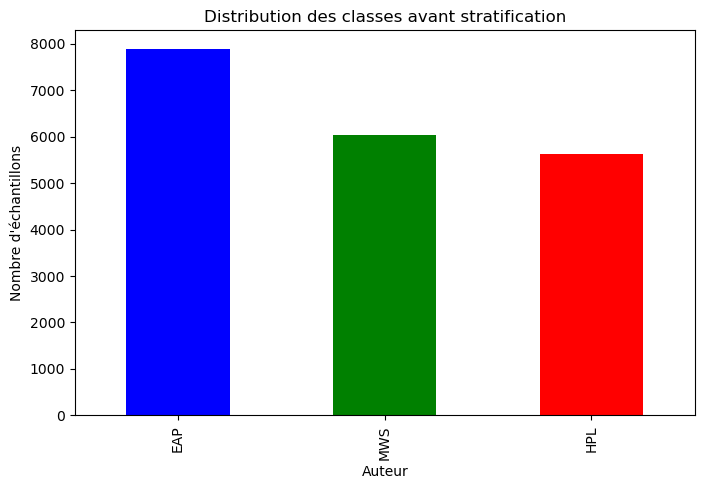

In [9]:
df = data

plt.figure(figsize=(8,5))
df["author"].value_counts().plot(kind="bar", color=['blue', 'green', 'red'])
plt.title("Distribution des classes avant stratification")
plt.xlabel("Auteur")
plt.ylabel("Nombre d'échantillons")
plt.show()


In [10]:
df.dropna(inplace=True)

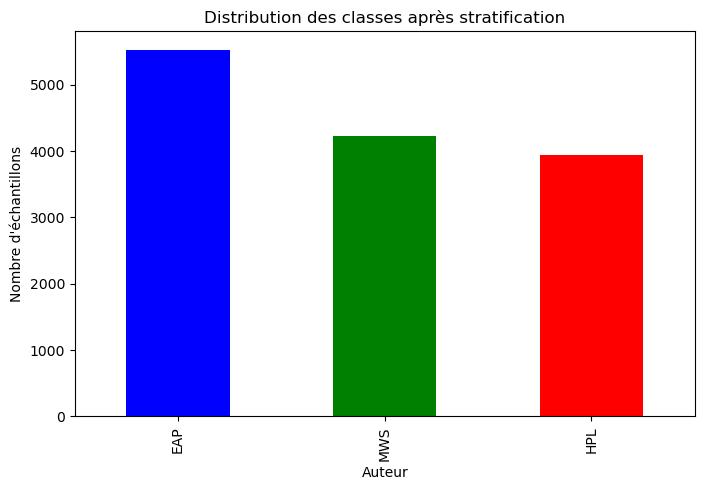

In [11]:
X = df["cleaned_text"]  # Texte prétraité
y = df["author"]  # Label (auteur)

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=0, stratify=y
)

plt.figure(figsize=(8,5))
pd.Series(y_train).value_counts().plot(kind="bar", color=['blue', 'green', 'red'])
plt.title("Distribution des classes après stratification")
plt.xlabel("Auteur")
plt.ylabel("Nombre d'échantillons")
plt.show()


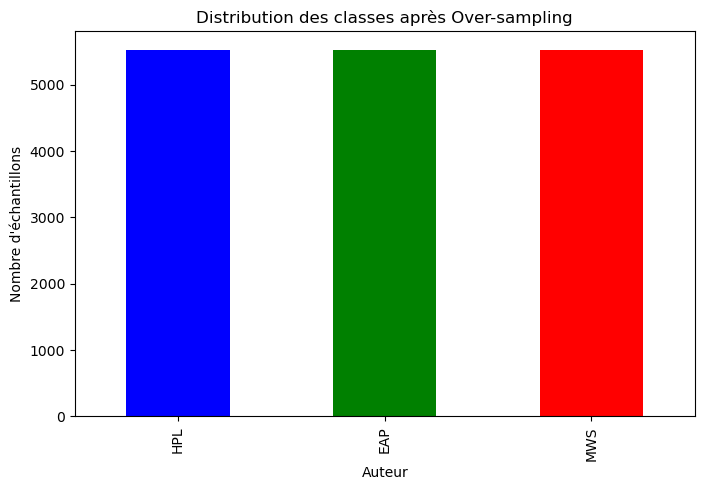

In [12]:
oversampler = RandomOverSampler(random_state=0)  
 
X_resampled, y_resampled = oversampler.fit_resample(X_train.to_frame(), y_train)

plt.figure(figsize=(8,5))
pd.Series(y_resampled).value_counts().plot(kind="bar", color=['blue', 'green', 'red'])
plt.title("Distribution des classes après Over-sampling")
plt.xlabel("Auteur")
plt.ylabel("Nombre d'échantillons")
plt.show()


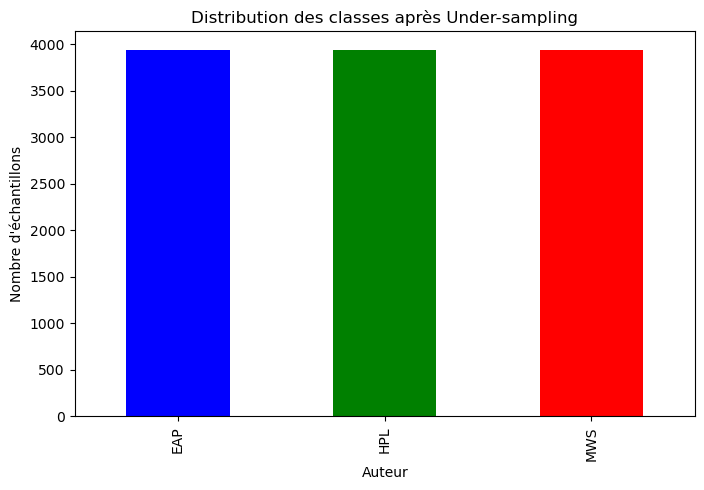

In [15]:
undersampler = RandomUnderSampler(random_state=0)

X_resampled, y_resampled = undersampler.fit_resample(X_train.to_frame(), y_train)

plt.figure(figsize=(8,5))
pd.Series(y_resampled).value_counts().plot(kind="bar", color=['blue', 'green', 'red'])
plt.title("Distribution des classes après Under-sampling")
plt.xlabel("Auteur")
plt.ylabel("Nombre d'échantillons")
plt.show()


In [65]:
vectorizer = TfidfVectorizer()
X_train_tfidf = vectorizer.fit_transform(X_train)  # Matrice sparse
X_test_tfidf = vectorizer.transform(X_test)

# Vérifier le format (SMOTE attend une matrice dense)
X_train_tfidf_dense = X_train_tfidf.toarray()

smote = SMOTE(random_state=0)
X_resampled, y_resampled = smote.fit_resample(X_train_tfidf_dense, y_train)


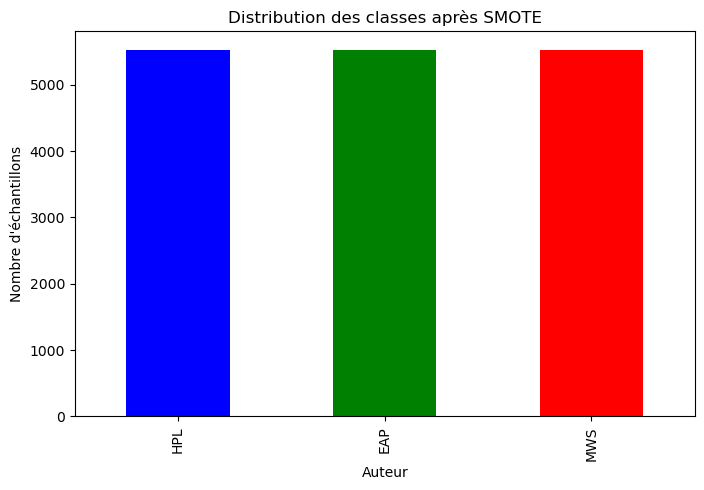

In [14]:
plt.figure(figsize=(8,5))
pd.Series(y_resampled).value_counts().plot(kind="bar", color=['blue', 'green', 'red'])
plt.title("Distribution des classes après SMOTE")
plt.xlabel("Auteur")
plt.ylabel("Nombre d'échantillons")
plt.show()

In [66]:
from imblearn.over_sampling import ADASYN

adasyn = ADASYN(random_state=0)
X_resampled, y_resampled = adasyn.fit_resample(X_train_tfidf_dense, y_train)


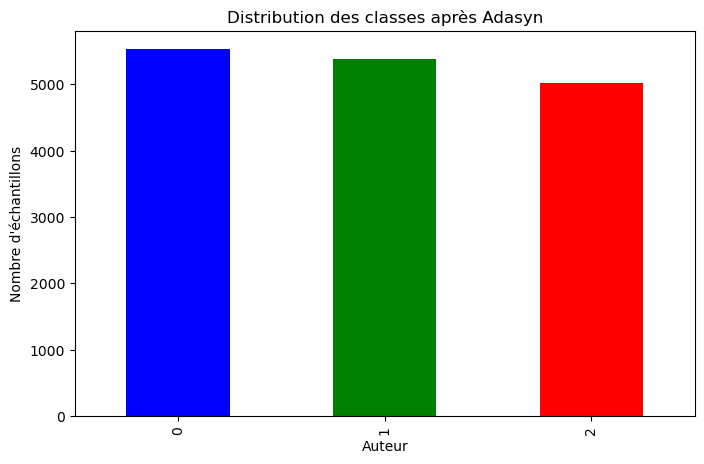

In [68]:
plt.figure(figsize=(8,5))
pd.Series(y_resampled).value_counts().plot(kind="bar", color=['blue', 'green', 'red'])
plt.title("Distribution des classes après Adasyn")
plt.xlabel("Auteur")
plt.ylabel("Nombre d'échantillons")
plt.show()

In [13]:
X_train, X_test, y_train, y_test = train_test_split(data['cleaned_text'].values, 
                                                    data['author_encoded'].values, 
                                                    test_size=0.3, 
                                                    random_state=33,
                                                    stratify = data['author_encoded'].values)

In [14]:
X_train.shape

(13703,)

## D. Méthodes de vectorisation 


<div class="alert alert-block alert-warning"> Utiliser la méthode de fréquence lexicale et one-hot encoding pour vectoriser le dataset d’entrainement et   
du test. 
<div/>

In [18]:
one_hot_vectorizer = CountVectorizer(binary=True)  # Mode binaire = One-Hot
X_train_onehot = one_hot_vectorizer.fit_transform(X_train)
X_test_onehot = one_hot_vectorizer.transform(X_test)

In [19]:
tf_vectorizer = CountVectorizer(binary=False)  # Mode normal = Fréquence des mots
X_train_tf = tf_vectorizer.fit_transform(X_train)
X_test_tf = tf_vectorizer.transform(X_test)

In [20]:
df_sparse = pd.DataFrame.sparse.from_spmatrix(X_train_onehot, columns=one_hot_vectorizer.get_feature_names_out())

print(df_sparse.head())

   aback  abandon  abandoned  abandoning  abandonment  abaout  abashed  \
0      0        0          0           0            0       0        0   
1      0        0          0           0            0       0        0   
2      0        0          0           0            0       0        0   
3      0        0          0           0            0       0        0   
4      0        0          0           0            0       0        0   

   abashment  abate  abatement  ...  zimer  zircon  zit  zobnarian  zodiacal  \
0          0      0          0  ...      0       0    0          0         0   
1          0      0          0  ...      0       0    0          0         0   
2          0      0          0  ...      0       0    0          0         0   
3          0      0          0  ...      0       0    0          0         0   
4          0      0          0  ...      0       0    0          0         0   

   zokar  zone  zones  zopyrus  zuro  
0      0     0      0        0     

In [21]:
df_sparse = pd.DataFrame.sparse.from_spmatrix(X_train_tf, columns=tf_vectorizer.get_feature_names_out())

print(df_sparse.head())

   aback  abandon  abandoned  abandoning  abandonment  abaout  abashed  \
0      0        0          0           0            0       0        0   
1      0        0          0           0            0       0        0   
2      0        0          0           0            0       0        0   
3      0        0          0           0            0       0        0   
4      0        0          0           0            0       0        0   

   abashment  abate  abatement  ...  zimer  zircon  zit  zobnarian  zodiacal  \
0          0      0          0  ...      0       0    0          0         0   
1          0      0          0  ...      0       0    0          0         0   
2          0      0          0  ...      0       0    0          0         0   
3          0      0          0  ...      0       0    0          0         0   
4          0      0          0  ...      0       0    0          0         0   

   zokar  zone  zones  zopyrus  zuro  
0      0     0      0        0     

In [22]:
# Sélectionner la première ligne
first_row = df_sparse.iloc[0]

# Filtrer les colonnes où la valeur est 1
columns_with_1 = first_row[first_row == 1].index.tolist()

print("🔹 Mots présents dans la première ligne :", columns_with_1)

🔹 Mots présents dans la première ligne : ['actions', 'great', 'guard', 'lunatic', 'others', 'point', 'set']


In [23]:
X_train[0]

'great point set lunatic guard actions others'


<div class="alert alert-block alert-warning"> 2. Entrainer un modèle de vectorisation TF-IDF sur la partie d’entrainement et vectorisez-le. 
<div/>

In [24]:
tfidf_vectorizer = TfidfVectorizer()

X_train_tfidf = tfidf_vectorizer.fit_transform(X_train)

X_test_tfidf = tfidf_vectorizer.transform(X_test)

print(f"TF-IDF: Train = {X_train_tfidf.shape}, Test = {X_test_tfidf.shape}")


TF-IDF: Train = (13703, 23347), Test = (5874, 23347)


In [25]:
# Conversion en DataFrame Sparse pour économiser de la mémoire
df_tfidf_train = pd.DataFrame.sparse.from_spmatrix(X_train_tfidf, columns=tfidf_vectorizer.get_feature_names_out())

print("🔹 TF-IDF (extrait des 5 premières lignes) :")
print(df_tfidf_train.head())

🔹 TF-IDF (extrait des 5 premières lignes) :
   aback  abandon  abandoned  abandoning  abandonment  abaout  abashed  \
0      0        0          0           0            0       0        0   
1      0        0          0           0            0       0        0   
2      0        0          0           0            0       0        0   
3      0        0          0           0            0       0        0   
4      0        0          0           0            0       0        0   

   abashment  abate  abatement  ...  zimer  zircon  zit  zobnarian  zodiacal  \
0          0      0          0  ...      0       0    0          0         0   
1          0      0          0  ...      0       0    0          0         0   
2          0      0          0  ...      0       0    0          0         0   
3          0      0          0  ...      0       0    0          0         0   
4          0      0          0  ...      0       0    0          0         0   

   zokar  zone  zones  zopyrus

In [26]:
index = 0 
sample_row = X_train_tfidf[index].toarray().flatten()

# Créer un dictionnaire mot -> score TF-IDF
word_tfidf = {word: sample_row[i] for i, word in enumerate(tfidf_vectorizer.get_feature_names_out())}

# Trier les mots par score décroissant
sorted_words = sorted(word_tfidf.items(), key=lambda x: x[1], reverse=True)

print("🔹 Top 10 mots les plus importants dans la phrase :", sorted_words[:10])


🔹 Top 10 mots les plus importants dans la phrase : [('lunatic', 0.49294644757465345), ('guard', 0.4412291787312603), ('actions', 0.41470124037554346), ('set', 0.3324836012168769), ('others', 0.3287724628718644), ('point', 0.3167969115452687), ('great', 0.2671077166707419), ('aback', 0.0), ('abandon', 0.0), ('abandoned', 0.0)]


In [27]:
df_sample = pd.DataFrame(sample_row, index=tfidf_vectorizer.get_feature_names_out(), columns=["TF-IDF Score"])
df_sample = df_sample[df_sample["TF-IDF Score"] > 0]  # Ne garder que les mots présents
print(df_sample.sort_values(by="TF-IDF Score", ascending=False).head(10))

         TF-IDF Score
lunatic      0.492946
guard        0.441229
actions      0.414701
set          0.332484
others       0.328772
point        0.316797
great        0.267108


## E. Entrainement 


<div class="alert alert-block alert-warning">1. 
Créer trois modèles du type MLPClassifier. (Vous pouvez changer l’algorithme d’apprentissage : utiliser    
les autres algorithmes de scikit-learn) 
<div/>


<div class="alert alert-block alert-warning">2. Entrainer ces trois modèles sur les trois représentations vectorielles.
<div/>

In [ ]:
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score, classification_report

# Définition des modèles avec différents solveurs (algorithmes d'apprentissage)
mlp_1 = MLPClassifier(hidden_layer_sizes=(100,), solver='adam', max_iter=300, random_state=0)
mlp_2 = MLPClassifier(hidden_layer_sizes=(100,), solver='sgd', max_iter=300, random_state=0)
mlp_3 = MLPClassifier(hidden_layer_sizes=(100,), solver='lbfgs', max_iter=300, random_state=0)

# Entraînement sur les trois représentations vectorielles
print("🔹 Entraînement sur One-Hot Encoding...")
mlp_1.fit(X_train_onehot, y_train)

print("🔹 Entraînement sur TF (Fréquence lexicale)...")
mlp_2.fit(X_train_tf, y_train)

print("🔹 Entraînement sur TF-IDF...")
mlp_3.fit(X_train_tfidf, y_train)


In [151]:
# import joblib

# # Sauvegarder les modèles
# joblib.dump(mlp_1, "mlp_onehot.pkl")
# joblib.dump(mlp_2, "mlp_tf.pkl")
# joblib.dump(mlp_3, "mlp_tfidf.pkl")

In [26]:
import joblib

# Charger les modèles sauvegardés
mlp_1 = joblib.load("mlp_onehot.pkl")
mlp_2 = joblib.load("mlp_tf.pkl")
mlp_3 = joblib.load("mlp_tfidf.pkl")


<div class="alert alert-block alert-warning">3. Prédire les classes en appliquant les trois modèles sur les trois représentations d’entrainement. 
<div/>


<div class="alert alert-block alert-warning">4. Afficher le rapport de classification en utilisant les mesures de performance (accuracy, precision, 
recall…). <div/>

In [27]:
y_pred_1_train = mlp_1.predict(X_train_onehot)
y_pred_2_train = mlp_2.predict(X_train_tf)
y_pred_3_train = mlp_3.predict(X_train_tfidf)

print("🔹 Modèle 1 (One-Hot Encoding) :")
print("Accuracy:", accuracy_score(y_train, y_pred_1_train))
print(classification_report(y_train, y_pred_1_train))

print("\n🔹 Modèle 2 (TF - Fréquence lexicale) :")
print("Accuracy:", accuracy_score(y_train, y_pred_2_train))
print(classification_report(y_train, y_pred_2_train))

print("\n🔹 Modèle 3 (TF-IDF) :")
print("Accuracy:", accuracy_score(y_train, y_pred_3_train))
print(classification_report(y_train, y_pred_3_train))

🔹 Modèle 1 (One-Hot Encoding) :
Accuracy: 0.9998540465591477
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      5529
           1       1.00      1.00      1.00      3944
           2       1.00      1.00      1.00      4230

    accuracy                           1.00     13703
   macro avg       1.00      1.00      1.00     13703
weighted avg       1.00      1.00      1.00     13703


🔹 Modèle 2 (TF - Fréquence lexicale) :
Accuracy: 0.9636575932277603
              precision    recall  f1-score   support

           0       0.94      0.98      0.96      5529
           1       0.98      0.96      0.97      3944
           2       0.98      0.95      0.96      4230

    accuracy                           0.96     13703
   macro avg       0.97      0.96      0.96     13703
weighted avg       0.96      0.96      0.96     13703


🔹 Modèle 3 (TF-IDF) :
Accuracy: 0.9998540465591477
              precision    recall  f1-score   support

 

## F. Test


<div class="alert alert-block alert-warning">1. Prédire les classes en appliquant les trois modèles sur les trois représentations de test. 
<div/>

In [ ]:
y_pred_1 = mlp_1.predict(X_test_onehot)
y_pred_2 = mlp_2.predict(X_test_tf)
y_pred_3 = mlp_3.predict(X_test_tfidf)


<div class="alert alert-block alert-warning">2. 
Afficher le rapport de classification en utilisant les mesures de performance (accuracy, precision, 
recall…)  
<div/>

In [29]:
print("🔹 Modèle 1 (One-Hot Encoding) :")
print("Accuracy:", accuracy_score(y_test, y_pred_1))
print(classification_report(y_test, y_pred_1))

print("\n🔹 Modèle 2 (TF - Fréquence lexicale) :")
print("Accuracy:", accuracy_score(y_test, y_pred_2))
print(classification_report(y_test, y_pred_2))

print("\n🔹 Modèle 3 (TF-IDF) :")
print("Accuracy:", accuracy_score(y_test, y_pred_3))
print(classification_report(y_test, y_pred_3))


🔹 Modèle 1 (One-Hot Encoding) :
Accuracy: 0.7504256043581886
              precision    recall  f1-score   support

           0       0.75      0.76      0.76      2370
           1       0.78      0.72      0.75      1690
           2       0.72      0.76      0.74      1814

    accuracy                           0.75      5874
   macro avg       0.75      0.75      0.75      5874
weighted avg       0.75      0.75      0.75      5874


🔹 Modèle 2 (TF - Fréquence lexicale) :
Accuracy: 0.803030303030303
              precision    recall  f1-score   support

           0       0.77      0.86      0.82      2370
           1       0.84      0.75      0.79      1690
           2       0.81      0.77      0.79      1814

    accuracy                           0.80      5874
   macro avg       0.81      0.80      0.80      5874
weighted avg       0.81      0.80      0.80      5874


🔹 Modèle 3 (TF-IDF) :
Accuracy: 0.7878787878787878
              precision    recall  f1-score   support

  

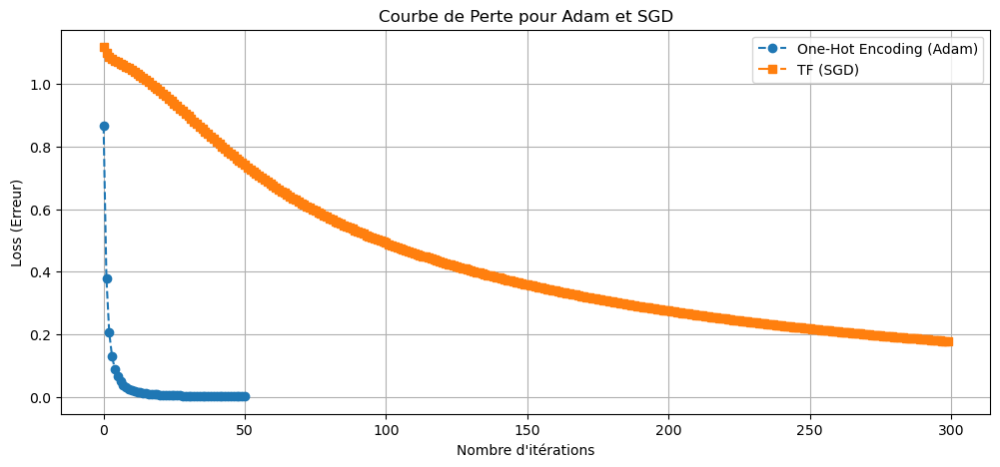

In [33]:
plt.figure(figsize=(12, 5))

plt.plot(mlp_1.loss_curve_, label="One-Hot Encoding (Adam)", linestyle="--", marker="o")

plt.plot(mlp_2.loss_curve_, label="TF (SGD)", linestyle="-.", marker="s")

plt.xlabel("Nombre d'itérations")
plt.ylabel("Loss (Erreur)")
plt.title("Courbe de Perte pour Adam et SGD")
plt.legend()
plt.grid()
plt.show()


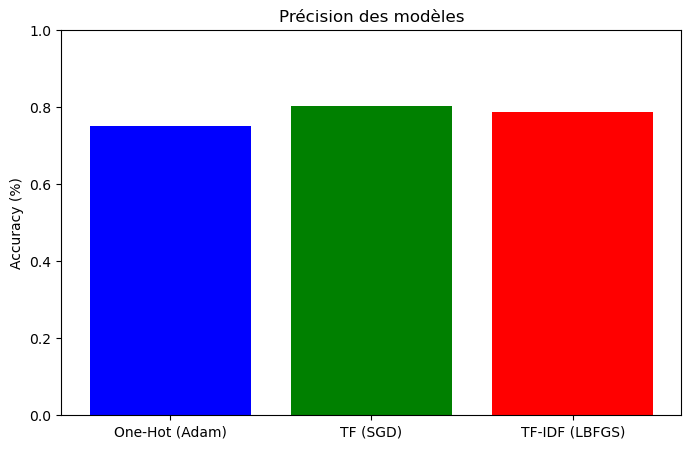

In [ ]:
accuracy_onehot = accuracy_score(y_test, mlp_1.predict(X_test_onehot))
accuracy_tf = accuracy_score(y_test, mlp_2.predict(X_test_tf))
accuracy_tfidf = accuracy_score(y_test, mlp_3.predict(X_test_tfidf))

plt.figure(figsize=(8, 5))
plt.bar(["One-Hot (Adam)", "TF (SGD)", "TF-IDF (LBFGS)"], [accuracy_onehot, accuracy_tf, accuracy_tfidf], color=["blue", "green", "red"])
plt.ylabel("Accuracy (%)")
plt.title("Précision des modèles")
plt.ylim(0, 1)
plt.show()


<div class="alert alert-block alert-warning">3. Calculer le temps de prédiction pour chaque modèle 
<div/>

In [ ]:
import time

prediction_times = {}

start_time = time.time()
y_pred_1 = mlp_1.predict(X_test_onehot)
prediction_times["One-Hot"] = time.time() - start_time

start_time = time.time()
y_pred_2 = mlp_2.predict(X_test_tf)
prediction_times["TF"] = time.time() - start_time

start_time = time.time()
y_pred_3 = mlp_3.predict(X_test_tfidf)
prediction_times["TF-IDF"] = time.time() - start_time

In [36]:
print("\n🔹 Temps de prédiction pour chaque modèle :")
for method, time_taken in prediction_times.items():
    print(f"{method}: {time_taken:.4f} secondes")



🔹 Temps de prédiction pour chaque modèle :
One-Hot: 0.0152 secondes
TF: 0.0194 secondes
TF-IDF: 0.0109 secondes


## G. Vectorisations basées sur les embeddings de mots 

In [15]:
X_train_tokens = [text.split() for text in X_train] 
X_test_tokens = [text.split() for text in X_test]

In [17]:
data["tokenized_text"] = data["cleaned_text"].apply(lambda x: simple_preprocess(x))

In [18]:
data["tokenized_text"].head()

0    [proces, however, afforded, means, ascertainin...
1    [never, occurred, fumbling, might, mere, mistake]
2    [left, hand, gold, snuff, box, capered, hil, c...
3    [lovely, spring, looked, windsor, terrace, six...
4    [finding, nothing, else, even, gold, superinte...
Name: tokenized_text, dtype: object


<div class="alert alert-block alert-warning">a. Word2Vec (CBOW et Skip gram) 
<div/>

In [ ]:
from gensim.models import Word2Vec

# Train CBOW model
word2vec_cbow = Word2Vec(sentences=data["tokenized_text"], vector_size=100, window=5, min_count=2, workers=4, sg=0)

# Train Skip-gram model
word2vec_sg = Word2Vec(sentences=data["tokenized_text"], vector_size=100, window=5, min_count=2, workers=4, sg=1)

In [41]:
print("🔹 Mots les plus similaires à 'king' (CBOW) :", word2vec_cbow.wv.most_similar("king"))

print("🔹 Mots les plus similaires à 'king' (Skip-gram) :", word2vec_sg.wv.most_similar("king"))

🔹 Mots les plus similaires à 'king' (CBOW) : [('spirit', 0.9997952580451965), ('close', 0.9997723698616028), ('moment', 0.9997592568397522), ('take', 0.9997580051422119), ('idea', 0.9997572302818298), ('sense', 0.9997528791427612), ('new', 0.9997501969337463), ('find', 0.9997494220733643), ('set', 0.9997451305389404), ('inded', 0.9997451305389404)]
🔹 Mots les plus similaires à 'king' (Skip-gram) : [('hither', 0.9976881742477417), ('merival', 0.9976639747619629), ('resided', 0.9975741505622864), ('leader', 0.9975160956382751), ('thither', 0.997438371181488), ('victims', 0.9974176287651062), ('manuscript', 0.9973669052124023), ('aylesbury', 0.9973088502883911), ('regained', 0.9973083734512329), ('alfred', 0.9972987174987793)]


In [42]:
print("🔹 Similarité entre 'man' et 'woman' (CBOW) :", word2vec_cbow.wv.similarity("man", "woman"))
print("🔹 Similarité entre 'man' et 'woman' (Skip-gram) :", word2vec_sg.wv.similarity("man", "woman"))


🔹 Similarité entre 'man' et 'woman' (CBOW) : 0.9991815
🔹 Similarité entre 'man' et 'woman' (Skip-gram) : 0.9119409


In [43]:
print("🔹 Paris - France + Germany = ?", word2vec_cbow.wv.most_similar(positive=["paris", "germany"], negative=["france"]))


🔹 Paris - France + Germany = ? [('distinction', 0.9911827445030212), ('harmless', 0.9910480380058289), ('laugh', 0.9910356998443604), ('permitted', 0.9909687638282776), ('cellar', 0.990845799446106), ('rocks', 0.9908069372177124), ('especial', 0.9907779097557068), ('population', 0.9907076358795166), ('favour', 0.9907063245773315), ('cap', 0.9907061457633972)]



<div class="alert alert-block alert-warning">b. Glove 
<div/>

In [34]:
import numpy as np

# Load GloVe embeddings
glove_path = "glove.6B.100d.txt"
glove_embeddings = {}

with open(glove_path, "r", encoding="utf-8") as f:
    for line in f:
        values = line.split()
        word = values[0]
        vector = np.array(values[1:], dtype="float32")
        glove_embeddings[word] = vector



<div class="alert alert-block alert-warning">c. FastText
<div/>

In [35]:
fasttext_model = FastText(sentences=data["tokenized_text"], vector_size=100, window=5, min_count=2, workers=4)

In [46]:
from sklearn.decomposition import PCA

#pass the embeddings to PCA
pca = PCA(n_components=2)
result = pca.fit_transform(word2vec_sg.wv.vectors)

#create df from the pca results
pca_df = pd.DataFrame(result, columns = ['x','y'])

#add the words for the hover effect
pca_df['word'] = word2vec_sg.wv.index_to_key
pca_df.head()

,x,y,word
0,0.559712,0.289218,one
1,0.425423,-0.462008,upon
2,0.596990,0.923796,could
3,0.585736,1.059978,would
4,0.583055,0.544393,time


In [47]:
import plotly.graph_objs as go

N = 1000000
words = list(word2vec_sg.wv.index_to_key)
fig = go.Figure(data=go.Scattergl(
   x = pca_df['x'],
   y = pca_df['y'],
   mode='markers',
   marker=dict(
       color=np.random.randn(N),
       colorscale='Viridis',
       line_width=1
   ),
   text=pca_df['word'],
   textposition="bottom center"
))

fig.show()

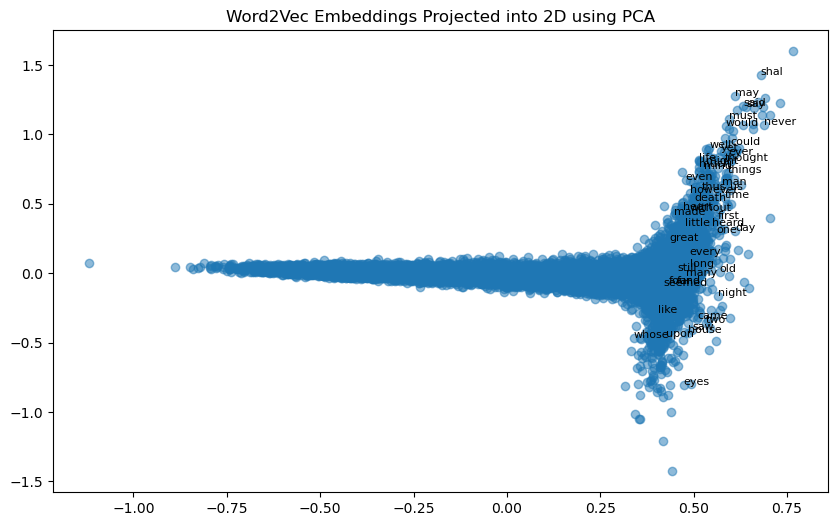

In [48]:
# Plot words in 2D space
plt.figure(figsize=(10, 6))
plt.scatter(pca_df['x'], pca_df['y'], alpha=0.5)

# Annotate words
for i, word in enumerate(pca_df['word'][:50]):  # Display only first 50 words
    plt.annotate(word, (pca_df['x'][i], pca_df['y'][i]), fontsize=8)

plt.title("Word2Vec Embeddings Projected into 2D using PCA")
plt.show()


In [49]:
from sklearn.manifold import TSNE

# Reduce Word2Vec embeddings to 2D using t-SNE
tsne = TSNE(n_components=2, perplexity=30, random_state=0, n_iter=1000)
result_tsne = tsne.fit_transform(word2vec_sg.wv.vectors)

import pandas as pd

# Store t-SNE results in a DataFrame
tsne_df = pd.DataFrame(result_tsne, columns=['x', 'y'])

# Add words for labeling
tsne_df['word'] = word2vec_sg.wv.index_to_key



c:\Users\pc cam\anaconda3\envs\exam_env\Lib\site-packages\sklearn\manifold\_t_sne.py:1164: FutureWarning:

'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.



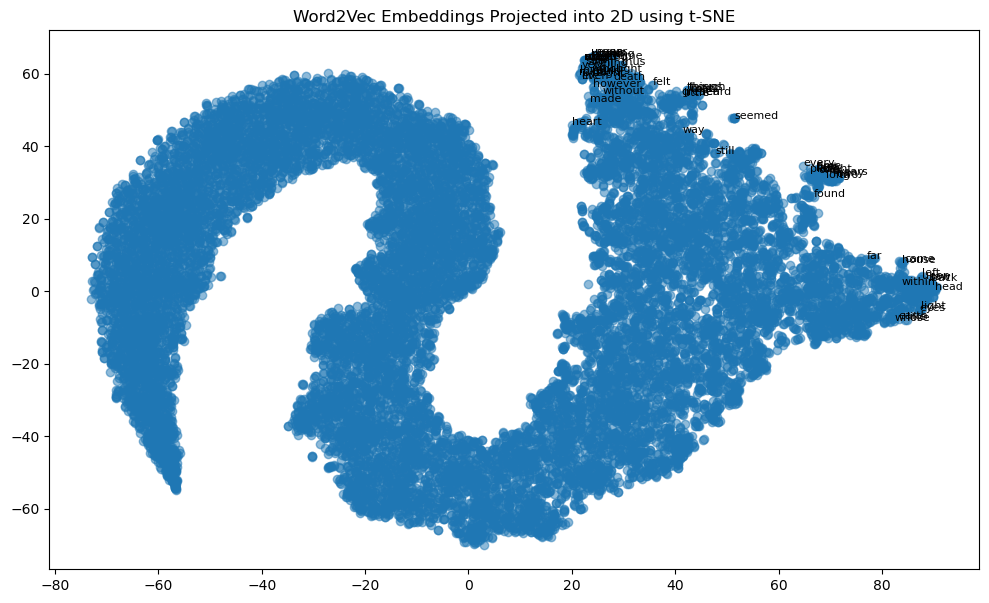

In [50]:
plt.figure(figsize=(12, 7))
plt.scatter(tsne_df['x'], tsne_df['y'], alpha=0.5)

for i, word in enumerate(tsne_df['word'][:70]):
    plt.annotate(word, (tsne_df['x'][i], tsne_df['y'][i]), fontsize=8)

plt.title("Word2Vec Embeddings Projected into 2D using t-SNE")
plt.show()

In [36]:
def get_sentence_vector(words, model):
    """Get the average word vector for a sentence."""
    word_vectors = [model.wv[word] for word in words if word in model.wv]
    return np.mean(word_vectors, axis=0) if word_vectors else np.zeros(100)

In [52]:
print(X_train[:5])  # Check the first 5 elements

['great point set lunatic guard actions others' 'city comparative repose'
 'alluded coldness leters minutes spent together sufficiently explained origin'
 'one dog remained alive human within sailors persuading enter vesel'
 'book fell open almost accord frequent consultation place repellent twelfth plate shewing butchers shop amongst anzique canibals']


In [37]:
X_train_tokens = [sentence.split() for sentence in X_train]
X_test_tokens = [sentence.split() for sentence in X_test]

In [38]:
# Appliquer Word2Vec CBOW
X_train_w2v_cbow = np.array([get_sentence_vector(text, word2vec_cbow) for text in X_train_tokens])
X_test_w2v_cbow = np.array([get_sentence_vector(text, word2vec_cbow) for text in X_test_tokens])

# Appliquer Word2Vec Skip-Gram
X_train_w2v_sg = np.array([get_sentence_vector(text, word2vec_sg) for text in X_train_tokens])
X_test_w2v_sg = np.array([get_sentence_vector(text, word2vec_sg) for text in X_test_tokens])

# Appliquer FastText
X_train_fasttext = np.array([get_sentence_vector(text, fasttext_model) for text in X_train_tokens])
X_test_fasttext = np.array([get_sentence_vector(text, fasttext_model) for text in X_test_tokens])

In [39]:
X_train_w2v_sg[220]

array([-0.05805524,  0.16930366, -0.01613045,  0.00433207,  0.01723394,
       -0.31397793, -0.02001349,  0.4283036 , -0.09263209, -0.10495755,
       -0.14445327, -0.29784167, -0.10040554,  0.15078545,  0.04844492,
       -0.09900042,  0.14322288, -0.24978977,  0.03646996, -0.40024203,
        0.15957133,  0.11077177,  0.21461388, -0.10877036, -0.07975987,
        0.04486955, -0.17415813, -0.10077078, -0.2014392 ,  0.02157769,
        0.19617528,  0.01097791,  0.11515836, -0.17941113, -0.01547866,
        0.15854934,  0.08635137, -0.16025347, -0.11538982, -0.3201409 ,
       -0.00467595, -0.20690461, -0.09543691,  0.03813254,  0.22757135,
       -0.13612592, -0.1932878 , -0.08276867,  0.17440663,  0.24262463,
        0.08179364, -0.18051372, -0.09404773, -0.00238677, -0.08818761,
        0.06884905,  0.14288083, -0.04409014, -0.21149328,  0.15773804,
       -0.0453953 ,  0.12643091, -0.08269649,  0.14886083, -0.09296224,
        0.18503666,  0.08736011,  0.14439021, -0.23874412,  0.16

In [40]:
# Appliquer GloVe
def get_glove_vector(tokens, glove_dict, embedding_dim=100):
    vectors = [glove_dict[word] for word in tokens if word in glove_dict]
    return np.mean(vectors, axis=0) if vectors else np.zeros(embedding_dim)

X_train_glove = np.array([get_glove_vector(text, glove_embeddings) for text in X_train_tokens])
X_test_glove = np.array([get_glove_vector(text, glove_embeddings) for text in X_test_tokens])

In [41]:
X_train_glove

array([[ 0.22668073, -0.02510925,  0.1802614 , ..., -0.44122288,
         0.17468755,  0.18134615],
       [ 0.168797  ,  0.33180565,  0.16932167, ..., -0.20994999,
         0.3823967 ,  0.34510967],
       [-0.05666126,  0.104222  ,  0.04892962, ..., -0.21664625,
         0.07688874, -0.03588449],
       ...,
       [ 0.174953  , -0.1360919 ,  0.30736086, ..., -0.09815157,
         0.26890475,  0.0425727 ],
       [ 0.0577643 ,  0.18163005,  0.18799385, ..., -0.22253619,
         0.01442537,  0.06535601],
       [ 0.005553  ,  0.1951893 ,  0.30872777, ..., -0.44973776,
        -0.01037256,  0.19641052]])

In [58]:
mlp_cbow = MLPClassifier(hidden_layer_sizes=(100,), solver='adam', max_iter=1500, random_state=0)
mlp_sg = MLPClassifier(hidden_layer_sizes=(100,), solver='adam', max_iter=1500, random_state=0)
mlp_glove = MLPClassifier(hidden_layer_sizes=(100,), solver='adam', max_iter=1500, random_state=0)
mlp_fasttext = MLPClassifier(hidden_layer_sizes=(100,), solver='adam', max_iter=1500, random_state=0)

mlp_cbow.fit(X_train_w2v_cbow, y_train)
mlp_sg.fit(X_train_w2v_sg, y_train)
mlp_glove.fit(X_train_glove, y_train)
mlp_fasttext.fit(X_train_fasttext, y_train)

MLPClassifier(max_iter=1500, random_state=0)

In [59]:
y_pred_cbow = mlp_cbow.predict(X_test_w2v_cbow)
y_pred_sg = mlp_sg.predict(X_test_w2v_sg)
y_pred_glove = mlp_glove.predict(X_test_glove)
y_pred_fasttext = mlp_fasttext.predict(X_test_fasttext)

print("🔹 Word2Vec CBOW")
print(classification_report(y_test, y_pred_cbow))

print("\n🔹 Word2Vec Skip-Gram")
print(classification_report(y_test, y_pred_sg))

print("\n🔹 GloVe")
print(classification_report(y_test, y_pred_glove))

print("\n🔹 FastText")
print(classification_report(y_test, y_pred_fasttext))

🔹 Word2Vec CBOW
              precision    recall  f1-score   support

           0       0.44      0.83      0.57      2370
           1       0.54      0.18      0.27      1690
           2       0.47      0.21      0.29      1814

    accuracy                           0.45      5874
   macro avg       0.48      0.41      0.38      5874
weighted avg       0.48      0.45      0.40      5874


🔹 Word2Vec Skip-Gram
              precision    recall  f1-score   support

           0       0.69      0.68      0.69      2370
           1       0.71      0.49      0.58      1690
           2       0.59      0.77      0.67      1814

    accuracy                           0.65      5874
   macro avg       0.66      0.65      0.65      5874
weighted avg       0.67      0.65      0.65      5874


🔹 GloVe
              precision    recall  f1-score   support

           0       0.63      0.62      0.63      2370
           1       0.58      0.56      0.57      1690
           2       0.58     

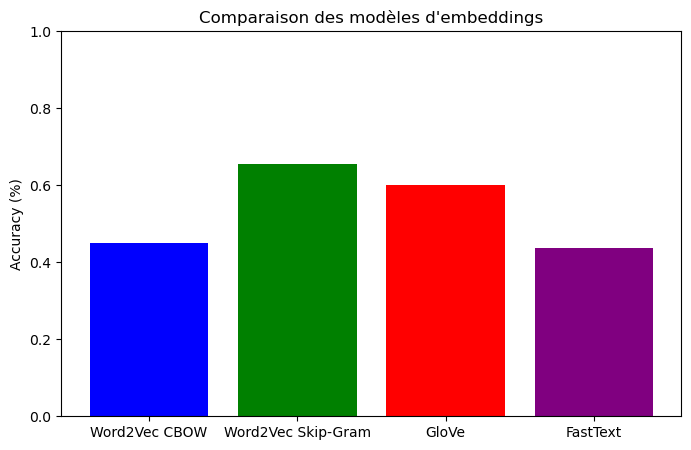

In [60]:
accuracies = [
    accuracy_score(y_test, y_pred_cbow),
    accuracy_score(y_test, y_pred_sg),
    accuracy_score(y_test, y_pred_glove),
    accuracy_score(y_test, y_pred_fasttext),
]

methods = ["Word2Vec CBOW", "Word2Vec Skip-Gram", "GloVe", "FastText"]

plt.figure(figsize=(8,5))
plt.bar(methods, accuracies, color=['blue', 'green', 'red', 'purple'])
plt.ylabel("Accuracy (%)")
plt.title("Comparaison des modèles d'embeddings")
plt.ylim(0, 1)
plt.show()

In [61]:
# More layers, better activation, lower learning rate
mlp_cbow2 = MLPClassifier(hidden_layer_sizes=(512, 256, 128), activation='relu', solver='adam',
                         learning_rate='adaptive', alpha=0.0001, max_iter=2000, random_state=0)
mlp_sg2 = MLPClassifier(hidden_layer_sizes=(512, 256, 128), activation='relu', solver='adam',
                       learning_rate='adaptive', alpha=0.0001, max_iter=2000, random_state=0)
mlp_glove2 = MLPClassifier(hidden_layer_sizes=(512, 256, 128), activation='relu', solver='adam',
                          learning_rate='adaptive', alpha=0.0001, max_iter=2000, random_state=0)
mlp_fasttext2 = MLPClassifier(hidden_layer_sizes=(512, 256, 128), activation='relu', solver='adam',
                             learning_rate='adaptive', alpha=0.0001, max_iter=2000, random_state=0)


mlp_cbow2.fit(X_train_w2v_cbow, y_train)
mlp_sg2.fit(X_train_w2v_sg, y_train)
mlp_glove2.fit(X_train_glove, y_train)
mlp_fasttext2.fit(X_train_fasttext, y_train)


MLPClassifier(hidden_layer_sizes=(512, 256, 128), learning_rate='adaptive',
              max_iter=2000, random_state=0)

In [62]:
y_pred_cbow = mlp_cbow2.predict(X_test_w2v_cbow)
y_pred_sg = mlp_sg2.predict(X_test_w2v_sg)
y_pred_glove = mlp_glove2.predict(X_test_glove)
y_pred_fasttext = mlp_fasttext2.predict(X_test_fasttext)

print("🔹 Word2Vec CBOW")
print(classification_report(y_test, y_pred_cbow))

print("\n🔹 Word2Vec Skip-Gram")
print(classification_report(y_test, y_pred_sg))

print("\n🔹 GloVe")
print(classification_report(y_test, y_pred_glove))

print("\n🔹 FastText")
print(classification_report(y_test, y_pred_fasttext))

🔹 Word2Vec CBOW
              precision    recall  f1-score   support

           0       0.43      0.85      0.57      2370
           1       0.50      0.34      0.40      1690
           2       0.00      0.00      0.00      1814

    accuracy                           0.44      5874
   macro avg       0.31      0.40      0.32      5874
weighted avg       0.32      0.44      0.34      5874


🔹 Word2Vec Skip-Gram
              precision    recall  f1-score   support

           0       0.61      0.68      0.65      2370
           1       0.61      0.54      0.57      1690
           2       0.63      0.61      0.62      1814

    accuracy                           0.62      5874
   macro avg       0.62      0.61      0.61      5874
weighted avg       0.62      0.62      0.62      5874


🔹 GloVe
              precision    recall  f1-score   support

           0       0.63      0.69      0.66      2370
           1       0.60      0.62      0.61      1690
           2       0.64     

c:\Users\pc cam\anaconda3\envs\exam_env\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\pc cam\anaconda3\envs\exam_env\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\pc cam\anaconda3\envs\exam_env\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [63]:
from sklearn.ensemble import RandomForestClassifier

rf_cbow = RandomForestClassifier(n_estimators=200, max_depth=50, random_state=0)
rf_sg = RandomForestClassifier(n_estimators=200, max_depth=50, random_state=0)
rf_glove = RandomForestClassifier(n_estimators=200, max_depth=50, random_state=0)
rf_fasttext = RandomForestClassifier(n_estimators=200, max_depth=50, random_state=0)

rf_cbow.fit(X_train_w2v_cbow, y_train)
rf_sg.fit(X_train_w2v_sg, y_train)
rf_glove.fit(X_train_glove, y_train)
rf_fasttext.fit(X_train_fasttext, y_train)

RandomForestClassifier(max_depth=50, n_estimators=200, random_state=0)

In [64]:
y_pred_cbow = rf_cbow.predict(X_test_w2v_cbow)
y_pred_sg = rf_sg.predict(X_test_w2v_sg)
y_pred_glove = rf_glove.predict(X_test_glove)
y_pred_fasttext = rf_fasttext.predict(X_test_fasttext)

print("🔹 Word2Vec CBOW")
print(classification_report(y_test, y_pred_cbow))

print("\n🔹 Word2Vec Skip-Gram")
print(classification_report(y_test, y_pred_sg))

print("\n🔹 GloVe")
print(classification_report(y_test, y_pred_glove))

print("\n🔹 FastText")
print(classification_report(y_test, y_pred_fasttext))

🔹 Word2Vec CBOW
              precision    recall  f1-score   support

           0       0.49      0.69      0.57      2370
           1       0.52      0.37      0.43      1690
           2       0.48      0.35      0.40      1814

    accuracy                           0.49      5874
   macro avg       0.50      0.47      0.47      5874
weighted avg       0.50      0.49      0.48      5874


🔹 Word2Vec Skip-Gram
              precision    recall  f1-score   support

           0       0.62      0.72      0.67      2370
           1       0.64      0.58      0.61      1690
           2       0.64      0.57      0.61      1814

    accuracy                           0.63      5874
   macro avg       0.63      0.62      0.63      5874
weighted avg       0.63      0.63      0.63      5874


🔹 GloVe
              precision    recall  f1-score   support

           0       0.59      0.78      0.67      2370
           1       0.63      0.44      0.52      1690
           2       0.63     

In [65]:
# Improved MLP Model
mlp_cbow3 = MLPClassifier(hidden_layer_sizes=(512, 256, 128), 
                          activation='tanh', solver='adam',
                          learning_rate='adaptive', learning_rate_init=0.0005,
                          alpha=0.0001, max_iter=5000, random_state=0)

mlp_sg3 = MLPClassifier(hidden_layer_sizes=(512, 256, 128), 
                        activation='tanh', solver='adam',
                        learning_rate='adaptive', learning_rate_init=0.0005,
                        alpha=0.0001, max_iter=5000, random_state=0)

mlp_glove3 = MLPClassifier(hidden_layer_sizes=(512, 256, 128), 
                           activation='tanh', solver='adam',
                           learning_rate='adaptive', learning_rate_init=0.0005,
                           alpha=0.0001, max_iter=5000, random_state=0)

mlp_fasttext3 = MLPClassifier(hidden_layer_sizes=(512, 256, 128), 
                              activation='tanh', solver='adam',
                              learning_rate='adaptive', learning_rate_init=0.0005,
                              alpha=0.0001, max_iter=5000, random_state=0)

mlp_cbow3.fit(X_train_w2v_cbow, y_train)
mlp_sg3.fit(X_train_w2v_sg, y_train)
mlp_glove3.fit(X_train_glove, y_train)
mlp_fasttext3.fit(X_train_fasttext, y_train)


MLPClassifier(activation='tanh', hidden_layer_sizes=(512, 256, 128),
              learning_rate='adaptive', learning_rate_init=0.0005,
              max_iter=5000, random_state=0)

In [66]:
y_pred_cbow3 = mlp_cbow3.predict(X_test_w2v_cbow)
y_pred_sg3 = mlp_sg3.predict(X_test_w2v_sg)
y_pred_glove3 = mlp_glove3.predict(X_test_glove)
y_pred_fasttext3 = mlp_fasttext3.predict(X_test_fasttext)

print("MLP CBOW Accuracy:", accuracy_score(y_test, y_pred_cbow3))
print("MLP Skip-Gram Accuracy:", accuracy_score(y_test, y_pred_sg3))
print("MLP GloVe Accuracy:", accuracy_score(y_test, y_pred_glove3))
print("MLP FastText Accuracy:", accuracy_score(y_test, y_pred_fasttext3))


MLP CBOW Accuracy: 0.46016343207354443
MLP Skip-Gram Accuracy: 0.6618998978549541
MLP GloVe Accuracy: 0.6052093973442288
MLP FastText Accuracy: 0.38423561457269323


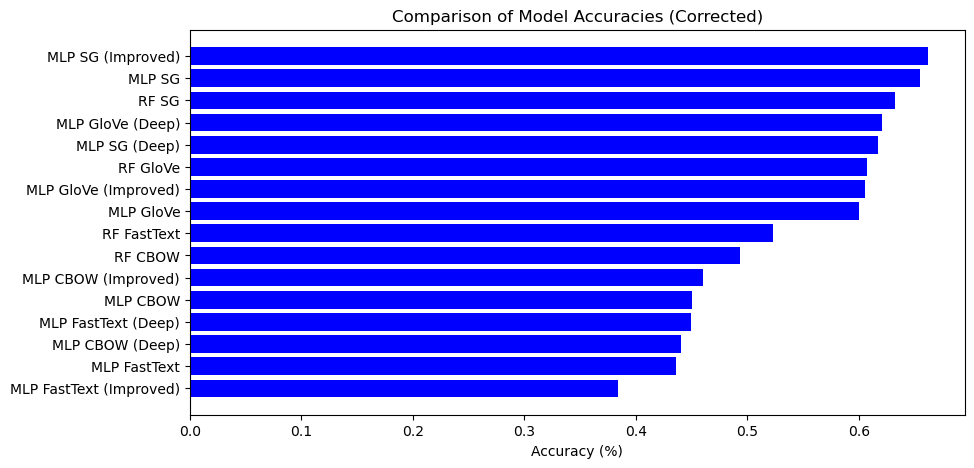

In [67]:
models = {
    "MLP CBOW": (mlp_cbow, X_test_w2v_cbow),
    "MLP SG": (mlp_sg, X_test_w2v_sg),
    "MLP GloVe": (mlp_glove, X_test_glove),
    "MLP FastText": (mlp_fasttext, X_test_fasttext),

    "MLP CBOW (Deep)": (mlp_cbow2, X_test_w2v_cbow),
    "MLP SG (Deep)": (mlp_sg2, X_test_w2v_sg),
    "MLP GloVe (Deep)": (mlp_glove2, X_test_glove),
    "MLP FastText (Deep)": (mlp_fasttext2, X_test_fasttext),
    
    "MLP CBOW (Improved)": (mlp_cbow3, X_test_w2v_cbow),
    "MLP SG (Improved)": (mlp_sg3, X_test_w2v_sg),
    "MLP GloVe (Improved)": (mlp_glove3, X_test_glove),
    "MLP FastText (Improved)": (mlp_fasttext3, X_test_fasttext),
    
    "RF CBOW": (rf_cbow, X_test_w2v_cbow),
    "RF SG": (rf_sg, X_test_w2v_sg),
    "RF GloVe": (rf_glove, X_test_glove),
    "RF FastText": (rf_fasttext, X_test_fasttext)
}

accuracies = {}
for name, (model, X_test) in models.items():
    y_pred = model.predict(X_test) 
    acc = accuracy_score(y_test, y_pred)
    accuracies[name] = acc

accuracies = dict(sorted(accuracies.items(), key=lambda x: x[1], reverse=True))

plt.figure(figsize=(10,5))
plt.barh(list(accuracies.keys()), list(accuracies.values()), color='blue')
plt.xlabel("Accuracy (%)")
plt.title("Comparison of Model Accuracies (Corrected)")
plt.gca().invert_yaxis() 
plt.show()

In [68]:
from sklearn.ensemble import StackingClassifier, VotingClassifier

base_models = [
    ('mlp_sg', mlp_sg), 
    ('rf_sg', rf_sg)
]

stacked_model = StackingClassifier(estimators=base_models, final_estimator=MLPClassifier())

stacked_model.fit(X_train_w2v_sg, y_train)

y_pred_stacked = stacked_model.predict(X_test_w2v_sg)
accuracy_stacked = accuracy_score(y_test, y_pred_stacked)
print(f"Stacked Model Accuracy: {accuracy_stacked:.4f}")


Stacked Model Accuracy: 0.6576


In [69]:
from sklearn.ensemble import StackingClassifier, VotingClassifier

base_models = [
    ('mlp_sg', mlp_sg), 
    ('rf_sg', rf_sg),
    ('mlp_glove_deep', mlp_glove2)
]

stacked_model = StackingClassifier(estimators=base_models, final_estimator=MLPClassifier())

stacked_model.fit(X_train_w2v_sg, y_train)

y_pred_stacked = stacked_model.predict(X_test_w2v_sg)
accuracy_stacked = accuracy_score(y_test, y_pred_stacked)
print(f"Stacked Model Accuracy: {accuracy_stacked:.4f}")

Stacked Model Accuracy: 0.6682


In [70]:
import numpy as np

def get_hybrid_embedding(tokens, w2v_sg, fasttext, glove_dict, embedding_dim=100):
    """Create hybrid embeddings by concatenating Word2Vec, FastText, and GloVe."""
    w2v_vector = np.mean([w2v_sg.wv[word] for word in tokens if word in w2v_sg.wv], axis=0) if any(word in w2v_sg.wv for word in tokens) else np.zeros(embedding_dim)
    fasttext_vector = np.mean([fasttext.wv[word] for word in tokens if word in fasttext.wv], axis=0) if any(word in fasttext.wv for word in tokens) else np.zeros(embedding_dim)
    glove_vector = np.mean([glove_dict[word] for word in tokens if word in glove_dict], axis=0) if any(word in glove_dict for word in tokens) else np.zeros(embedding_dim)
    
    return np.concatenate((w2v_vector, fasttext_vector, glove_vector))  

# Generate hybrid embeddings
X_train_hybrid = np.array([get_hybrid_embedding(text, word2vec_sg, fasttext_model, glove_embeddings) for text in X_train_tokens])
X_test_hybrid = np.array([get_hybrid_embedding(text, word2vec_sg, fasttext_model, glove_embeddings) for text in X_test_tokens])

print(f"Hybrid Embedding Shape: {X_train_hybrid.shape}")  # Should be (num_samples, 300)

Hybrid Embedding Shape: (13703, 300)


In [71]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv1D, MaxPooling1D, Flatten, Dense, Dropout

# Reshape input for CNN
X_train_hybrid_cnn = X_train_hybrid.reshape(X_train_hybrid.shape[0], X_train_hybrid.shape[1], 1)
X_test_hybrid_cnn = X_test_hybrid.reshape(X_test_hybrid.shape[0], X_test_hybrid.shape[1], 1)

# Define CNN Model
cnn_model = Sequential([
    Conv1D(filters=128, kernel_size=5, activation='relu', input_shape=(300, 1)),
    MaxPooling1D(pool_size=2),
    Conv1D(filters=64, kernel_size=3, activation='relu'),
    MaxPooling1D(pool_size=2),
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.5),
    Dense(len(set(y_train)), activation='softmax')  # Adjust output layer for multi-class classification
])

cnn_model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

cnn_model.fit(X_train_hybrid_cnn, y_train, epochs=100, batch_size=32, validation_data=(X_test_hybrid_cnn, y_test))

c:\Users\pc cam\anaconda3\envs\exam_env\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Epoch 1/100
429/429 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - accuracy: 0.4354 - loss: 1.0559 - val_accuracy: 0.5749 - val_loss: 0.9323
Epoch 2/100
429/429 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.5767 - loss: 0.9173 - val_accuracy: 0.6306 - val_loss: 0.8427
Epoch 3/100
429/429 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.6157 - loss: 0.8688 - val_accuracy: 0.6292 - val_loss: 0.8181
Epoch 4/100
429/429 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.6321 - loss: 0.8408 - val_accuracy: 0.6350 - val_loss: 0.8244
Epoch 5/100
429/429 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.6419 - loss: 0.8190 - val_accuracy: 0.6193 - val_loss: 0.8379
Epoch 6/100
429/429 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.6439 - loss: 0.8081 - val_accuracy: 0.6520 - val_loss: 0.7872
Epoch 7/100
429/429 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.6554 - loss: 0.7866 - val_accuracy: 0.6561 - val_loss: 0.7830
Epoch 8/100
429/429 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.6688 - loss: 0.7748 - val_acc

In [72]:
test_loss, test_acc = cnn_model.evaluate(X_test_hybrid_cnn, y_test)

print(f"\n📊 CNN Model Accuracy: {test_acc:.4f}")

184/184 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.6518 - loss: 1.5679

📊 CNN Model Accuracy: 0.6505


In [74]:
from sklearn.decomposition import PCA

# Apply PCA to reduce dimensionality
pca = PCA(n_components=200)  # Reduce from 300D → 200D
X_train_hybrid_pca = pca.fit_transform(X_train_hybrid)
X_test_hybrid_pca = pca.transform(X_test_hybrid)

# Reshape for CNN
X_train_hybrid_cnn = X_train_hybrid_pca.reshape(X_train_hybrid_pca.shape[0], X_train_hybrid_pca.shape[1], 1)
X_test_hybrid_cnn = X_test_hybrid_pca.reshape(X_test_hybrid_pca.shape[0], X_test_hybrid_pca.shape[1], 1)

print(f"New Shape After PCA: {X_train_hybrid_cnn.shape}")  # Should be (num_samples, 200, 1)


New Shape After PCA: (13703, 200, 1)


In [75]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv1D, MaxPooling1D, Flatten, Dense, Dropout, BatchNormalization
from tensorflow.keras.regularizers import l2

# Define an Enhanced CNN Model
cnn_model = Sequential([
    Conv1D(filters=256, kernel_size=5, activation='relu', kernel_regularizer=l2(0.001), input_shape=(200, 1)),
    BatchNormalization(),
    MaxPooling1D(pool_size=2),

    Conv1D(filters=128, kernel_size=3, activation='relu', kernel_regularizer=l2(0.001)),
    BatchNormalization(),
    MaxPooling1D(pool_size=2),

    Conv1D(filters=64, kernel_size=3, activation='relu', kernel_regularizer=l2(0.001)),
    BatchNormalization(),
    MaxPooling1D(pool_size=2),

    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.5),
    Dense(len(set(y_train)), activation='softmax')  # Multi-class classification
])

# Compile Model with Learning Rate Scheduling
optimizer = tf.keras.optimizers.Adam(learning_rate=0.0005)
cnn_model.compile(optimizer=optimizer, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Train Model
cnn_model.fit(X_train_hybrid_cnn, y_train, epochs=20, batch_size=32, validation_data=(X_test_hybrid_cnn, y_test))

Epoch 1/20


c:\Users\pc cam\anaconda3\envs\exam_env\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



429/429 ━━━━━━━━━━━━━━━━━━━━ 12s 22ms/step - accuracy: 0.3842 - loss: 1.4347 - val_accuracy: 0.4130 - val_loss: 1.3162
Epoch 2/20
429/429 ━━━━━━━━━━━━━━━━━━━━ 9s 21ms/step - accuracy: 0.4884 - loss: 1.2430 - val_accuracy: 0.5751 - val_loss: 1.1269
Epoch 3/20
429/429 ━━━━━━━━━━━━━━━━━━━━ 9s 20ms/step - accuracy: 0.5576 - loss: 1.1278 - val_accuracy: 0.5543 - val_loss: 1.1041
Epoch 4/20
429/429 ━━━━━━━━━━━━━━━━━━━━ 9s 21ms/step - accuracy: 0.5987 - loss: 1.0524 - val_accuracy: 0.6178 - val_loss: 1.0111
Epoch 5/20
429/429 ━━━━━━━━━━━━━━━━━━━━ 9s 20ms/step - accuracy: 0.6269 - loss: 0.9842 - val_accuracy: 0.6168 - val_loss: 0.9931
Epoch 6/20
429/429 ━━━━━━━━━━━━━━━━━━━━ 9s 20ms/step - accuracy: 0.6461 - loss: 0.9400 - val_accuracy: 0.6307 - val_loss: 0.9543
Epoch 7/20
429/429 ━━━━━━━━━━━━━━━━━━━━ 9s 20ms/step - accuracy: 0.6621 - loss: 0.9024 - val_accuracy: 0.6360 - val_loss: 0.9467
Epoch 8/20
429/429 ━━━━━━━━━━━━━━━━━━━━ 9s 21ms/step - accuracy: 0.6870 - loss: 0.8372 - val_accuracy: 0.61

In [76]:
test_loss, test_acc = cnn_model.evaluate(X_test_hybrid_cnn, y_test)

print(f"\n📊 Improved CNN Model Accuracy: {test_acc:.4f}")


184/184 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.6243 - loss: 1.2797

📊 Improved CNN Model Accuracy: 0.6297


In [77]:
import numpy as np

def get_hybrid_embedding(tokens, w2v_sg, fasttext, glove_dict, embedding_dim=100):
    """Create hybrid embeddings by concatenating Word2Vec, FastText, and GloVe."""
    w2v_vector = np.mean([w2v_sg.wv[word] for word in tokens if word in w2v_sg.wv], axis=0) if any(word in w2v_sg.wv for word in tokens) else np.zeros(embedding_dim)
    fasttext_vector = np.mean([fasttext.wv[word] for word in tokens if word in fasttext.wv], axis=0) if any(word in fasttext.wv for word in tokens) else np.zeros(embedding_dim)
    glove_vector = np.mean([glove_dict[word] for word in tokens if word in glove_dict], axis=0) if any(word in glove_dict for word in tokens) else np.zeros(embedding_dim)
    
    return np.concatenate((w2v_vector, fasttext_vector, glove_vector))  # Keep 300D full vectors

# Generate hybrid embeddings
X_train_hybrid = np.array([get_hybrid_embedding(text, word2vec_sg, fasttext_model, glove_embeddings) for text in X_train_tokens])
X_test_hybrid = np.array([get_hybrid_embedding(text, word2vec_sg, fasttext_model, glove_embeddings) for text in X_test_tokens])

print(f"Hybrid Embedding Shape: {X_train_hybrid.shape}")  # Should be (num_samples, 300)


Hybrid Embedding Shape: (13703, 300)


In [78]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv1D, MaxPooling1D, Flatten, Dense, Dropout, BatchNormalization, LSTM, Bidirectional

# Reshape input for CNN-LSTM
X_train_hybrid_cnn = X_train_hybrid.reshape(X_train_hybrid.shape[0], X_train_hybrid.shape[1], 1)
X_test_hybrid_cnn = X_test_hybrid.reshape(X_test_hybrid.shape[0], X_test_hybrid.shape[1], 1)

# Define a BiLSTM + CNN Model
model = Sequential([
    Conv1D(filters=128, kernel_size=5, activation='relu', input_shape=(300, 1)),
    MaxPooling1D(pool_size=2),
    BatchNormalization(),

    Bidirectional(LSTM(64, return_sequences=True, dropout=0.3, recurrent_dropout=0.3)),
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.4),
    Dense(len(set(y_train)), activation='softmax')  # Multi-class classification
])

# Compile Model with Optimized Learning Rate
optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)  # Slightly larger learning rate

model.compile(optimizer=optimizer, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Train Model
model.fit(X_train_hybrid_cnn, y_train, epochs=15, batch_size=64, validation_data=(X_test_hybrid_cnn, y_test))


Epoch 1/15
215/215 ━━━━━━━━━━━━━━━━━━━━ 79s 342ms/step - accuracy: 0.4175 - loss: 1.1881 - val_accuracy: 0.4823 - val_loss: 1.0760
Epoch 2/15
215/215 ━━━━━━━━━━━━━━━━━━━━ 93s 434ms/step - accuracy: 0.4999 - loss: 0.9856 - val_accuracy: 0.5950 - val_loss: 0.9357
Epoch 3/15
215/215 ━━━━━━━━━━━━━━━━━━━━ 91s 424ms/step - accuracy: 0.5470 - loss: 0.9398 - val_accuracy: 0.6282 - val_loss: 0.8695
Epoch 4/15
215/215 ━━━━━━━━━━━━━━━━━━━━ 95s 443ms/step - accuracy: 0.5586 - loss: 0.9119 - val_accuracy: 0.6313 - val_loss: 0.8519
Epoch 5/15
215/215 ━━━━━━━━━━━━━━━━━━━━ 95s 442ms/step - accuracy: 0.5696 - loss: 0.9066 - val_accuracy: 0.6313 - val_loss: 0.8282
Epoch 6/15
215/215 ━━━━━━━━━━━━━━━━━━━━ 95s 440ms/step - accuracy: 0.5886 - loss: 0.8807 - val_accuracy: 0.6551 - val_loss: 0.7922
Epoch 7/15
215/215 ━━━━━━━━━━━━━━━━━━━━ 92s 430ms/step - accuracy: 0.6063 - loss: 0.8630 - val_accuracy: 0.6379 - val_loss: 0.8151
Epoch 8/15
215/215 ━━━━━━━━━━━━━━━━━━━━ 94s 439ms/step - accuracy: 0.6010 - loss: 0

In [79]:
test_loss, test_acc = model.evaluate(X_test_hybrid_cnn, y_test)

print(f"\n📊 Improved BiLSTM-CNN Model Accuracy: {test_acc:.4f}")

184/184 ━━━━━━━━━━━━━━━━━━━━ 5s 27ms/step - accuracy: 0.6525 - loss: 0.7780

📊 Improved BiLSTM-CNN Model Accuracy: 0.6612


In [80]:
data["tokenized_text"]

0        [proces, however, afforded, means, ascertainin...
1        [never, occurred, fumbling, might, mere, mistake]
2        [left, hand, gold, snuff, box, capered, hil, c...
3        [lovely, spring, looked, windsor, terrace, six...
4        [finding, nothing, else, even, gold, superinte...
                               ...                        
19573    [stress, weather, drove, us, adriatic, gulph, ...
19574    [could, fancied, looked, eminent, landscape, p...
19575                    [lids, clenched, together, spasm]
19576    [mais, il, faut, agir, say, frenchman, never, ...
19577    [item, news, like, strikes, us, coolly, received]
Name: tokenized_text, Length: 19577, dtype: object

In [81]:
def get_meta_embedding(tokens, w2v_model, fasttext_model, glove_dict, embedding_dim=100):
    """Combine Word2Vec, FastText, and GloVe vectors by averaging them."""
    w2v_vector = np.mean([w2v_model.wv[word] for word in tokens if word in w2v_model.wv], axis=0) if any(word in w2v_model.wv for word in tokens) else np.zeros(embedding_dim)
    fasttext_vector = np.mean([fasttext_model.wv[word] for word in tokens if word in fasttext_model.wv], axis=0) if any(word in fasttext_model.wv for word in tokens) else np.zeros(embedding_dim)
    glove_vector = np.mean([glove_dict[word] for word in tokens if word in glove_dict], axis=0) if any(word in glove_dict for word in tokens) else np.zeros(embedding_dim)
    
    return np.concatenate((w2v_vector, fasttext_vector, glove_vector))  # 300D Meta-Embedding

# Generate meta-embeddings
X_train_meta = np.array([get_meta_embedding(text, word2vec_sg, fasttext_model, glove_embeddings) for text in X_train_tokens])
X_test_meta = np.array([get_meta_embedding(text, word2vec_sg, fasttext_model, glove_embeddings) for text in X_test_tokens])


In [82]:
X_train_meta

array([[-0.05416494,  0.16202947,  0.05768727, ..., -0.44122288,
         0.17468755,  0.18134615],
       [-0.06646403,  0.15110242,  0.08375552, ..., -0.20994999,
         0.3823967 ,  0.34510967],
       [-0.05909451,  0.1459835 ,  0.07162277, ..., -0.21664625,
         0.07688874, -0.03588449],
       ...,
       [-0.07319   ,  0.1477266 ,  0.0703006 , ..., -0.09815157,
         0.26890475,  0.0425727 ],
       [-0.05095969,  0.17262904,  0.07335573, ..., -0.22253619,
         0.01442537,  0.06535601],
       [-0.0368547 ,  0.15707961,  0.03254058, ..., -0.44973776,
        -0.01037256,  0.19641052]])

In [83]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv1D, MaxPooling1D, Flatten, Dense, Dropout, BatchNormalization

# Reshape input for CNN
X_train_meta_cnn = X_train_meta.reshape(X_train_meta.shape[0], X_train_meta.shape[1], 1)
X_test_meta_cnn = X_test_meta.reshape(X_test_meta.shape[0], X_test_meta.shape[1], 1)

# Define CNN Model
cnn_model = Sequential([
    Conv1D(filters=128, kernel_size=5, activation='relu', input_shape=(300, 1)),
    MaxPooling1D(pool_size=2),
    BatchNormalization(),

    Conv1D(filters=64, kernel_size=3, activation='relu'),
    MaxPooling1D(pool_size=2),
    Flatten(),

    Dense(128, activation='relu'),
    Dropout(0.5),
    Dense(len(set(y_train)), activation='softmax')  # Multi-class classification
])

# Compile Model
cnn_model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Train Model
cnn_model.fit(X_train_meta_cnn, y_train, epochs=30, batch_size=32, validation_data=(X_test_meta_cnn, y_test))


Epoch 1/30
429/429 ━━━━━━━━━━━━━━━━━━━━ 6s 13ms/step - accuracy: 0.4178 - loss: 1.2256 - val_accuracy: 0.5089 - val_loss: 1.0631
Epoch 2/30
429/429 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - accuracy: 0.4493 - loss: 1.0174 - val_accuracy: 0.5267 - val_loss: 0.9324
Epoch 3/30
429/429 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - accuracy: 0.4487 - loss: 1.0129 - val_accuracy: 0.5945 - val_loss: 0.9678
Epoch 4/30
429/429 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - accuracy: 0.4603 - loss: 0.9970 - val_accuracy: 0.6384 - val_loss: 0.9178
Epoch 5/30
429/429 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - accuracy: 0.5061 - loss: 0.9698 - val_accuracy: 0.6422 - val_loss: 0.9187
Epoch 6/30
429/429 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - accuracy: 0.5135 - loss: 0.9640 - val_accuracy: 0.6352 - val_loss: 0.8644
Epoch 7/30
429/429 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - accuracy: 0.5127 - loss: 0.9484 - val_accuracy: 0.6411 - val_loss: 0.8799
Epoch 8/30
429/429 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.5237 - loss: 0.9386 - val_accu

In [84]:
# Evaluate on test set
test_loss, test_acc = cnn_model.evaluate(X_test_meta_cnn, y_test)

print(f"\n📊 CNN Model Accuracy with Meta-Embeddings: {test_acc:.4f}")

184/184 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.6467 - loss: 0.8182

📊 CNN Model Accuracy with Meta-Embeddings: 0.6479


In [85]:
def get_fused_embedding(tokens, w2v_model, fasttext_model, glove_dict, embedding_dim=100):
    """Combine Word2Vec, FastText, and GloVe by averaging (instead of concatenation)."""
    vectors = []
    
    if any(word in w2v_model.wv for word in tokens):
        vectors.append(np.mean([w2v_model.wv[word] for word in tokens if word in w2v_model.wv], axis=0))
    
    if any(word in fasttext_model.wv for word in tokens):
        vectors.append(np.mean([fasttext_model.wv[word] for word in tokens if word in fasttext_model.wv], axis=0))
    
    if any(word in glove_dict for word in tokens):
        vectors.append(np.mean([glove_dict[word] for word in tokens if word in glove_dict], axis=0))
    
    if vectors:
        return np.mean(vectors, axis=0)  # Take the mean of all available embeddings
    else:
        return np.zeros(embedding_dim)  # Return a zero vector if no embedding exists

# Generate fused embeddings
X_train_fused = np.array([get_fused_embedding(text, word2vec_sg, fasttext_model, glove_embeddings) for text in X_train_tokens])
X_test_fused = np.array([get_fused_embedding(text, word2vec_sg, fasttext_model, glove_embeddings) for text in X_test_tokens])


In [86]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv1D, MaxPooling1D, Flatten, Dense, Dropout, BatchNormalization, LSTM, Bidirectional

# Reshape input for CNN-LSTM
X_train_fused_cnn = X_train_fused.reshape(X_train_fused.shape[0], X_train_fused.shape[1], 1)
X_test_fused_cnn = X_test_fused.reshape(X_test_fused.shape[0], X_test_fused.shape[1], 1)

# Define a BiLSTM + CNN Model
model = Sequential([
    Conv1D(filters=128, kernel_size=5, activation='relu', input_shape=(100, 1)),
    MaxPooling1D(pool_size=2),
    BatchNormalization(),

    Bidirectional(LSTM(64, return_sequences=True, dropout=0.3, recurrent_dropout=0.3)),
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.4),
    Dense(len(set(y_train)), activation='softmax')  # Multi-class classification
])

# Compile Model with Optimized Learning Rate
optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)  # Slightly larger learning rate

model.compile(optimizer=optimizer, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Train Model
model.fit(X_train_fused_cnn, y_train, epochs=30, batch_size=64, validation_data=(X_test_fused_cnn, y_test))


Epoch 1/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 17s 53ms/step - accuracy: 0.4716 - loss: 1.0434 - val_accuracy: 0.4185 - val_loss: 1.0565
Epoch 2/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 11s 53ms/step - accuracy: 0.5824 - loss: 0.9044 - val_accuracy: 0.5041 - val_loss: 0.9626
Epoch 3/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 13s 58ms/step - accuracy: 0.5892 - loss: 0.8944 - val_accuracy: 0.6200 - val_loss: 0.8461
Epoch 4/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 12s 58ms/step - accuracy: 0.6168 - loss: 0.8641 - val_accuracy: 0.5623 - val_loss: 0.9243
Epoch 5/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 13s 59ms/step - accuracy: 0.6077 - loss: 0.8588 - val_accuracy: 0.6195 - val_loss: 0.8368
Epoch 6/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 13s 61ms/step - accuracy: 0.6255 - loss: 0.8380 - val_accuracy: 0.6309 - val_loss: 0.8235
Epoch 7/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 13s 59ms/step - accuracy: 0.6132 - loss: 0.8411 - val_accuracy: 0.6137 - val_loss: 0.8590
Epoch 8/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 12s 58ms/step - accuracy: 0.6353 - loss: 0.8237 - 

In [87]:
# Evaluate on test set
test_loss, test_acc = model.evaluate(X_train_fused_cnn, y_train)

print(f"\n📊 Improved BiLSTM-CNN Model Accuracy: {test_acc:.4f}")


429/429 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7993 - loss: 0.4839

📊 Improved BiLSTM-CNN Model Accuracy: 0.7944


In [192]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score

# Get model predictions
y_pred_probs = model.predict(X_test_fused_cnn)  # Probabilities
y_pred = y_pred_probs.argmax(axis=1)  # Convert probabilities to class labels

# Compute performance metrics
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
f1 = f1_score(y_test, y_pred, average='weighted')

# Check if the task is binary classification for AUC calculation
if len(set(y_test)) == 2:
    auc = roc_auc_score(y_test, y_pred_probs[:, 1])  # Only for binary classification
else:
    auc = roc_auc_score(y_test, y_pred_probs, multi_class='ovr')

# Print evaluation results
print(f"\n📊 Model Evaluation Metrics:")
print(f"✅ Accuracy: {accuracy:.4f}")
print(f"✅ Precision: {precision:.4f}")
print(f"✅ Recall: {recall:.4f}")
print(f"✅ F1 Score: {f1:.4f}")
print(f"✅ AUC Score: {auc:.4f}")


184/184 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step

📊 Model Evaluation Metrics:
✅ Accuracy: 0.6444
✅ Precision: 0.6439
✅ Recall: 0.6444
✅ F1 Score: 0.6440
✅ AUC Score: 0.8110


In [45]:
import re
import numpy as np
import pandas as pd
import nltk
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Softmax, Lambda, Multiply, Conv1D, MaxPooling1D, Flatten, Dropout
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from gensim.models import Word2Vec, FastText
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

In [42]:
def get_individual_embeddings(tokens, w2v_model, fasttext_model, glove_dict, embedding_dim=100):
    """Return separate embeddings from Word2Vec, FastText, and GloVe instead of averaging them."""
    w2v_vector = np.mean([w2v_model.wv[word] for word in tokens if word in w2v_model.wv], axis=0) if any(word in w2v_model.wv for word in tokens) else np.zeros(embedding_dim)
    fasttext_vector = np.mean([fasttext_model.wv[word] for word in tokens if word in fasttext_model.wv], axis=0) if any(word in fasttext_model.wv for word in tokens) else np.zeros(embedding_dim)
    glove_vector = np.mean([glove_dict[word] for word in tokens if word in glove_dict], axis=0) if any(word in glove_dict for word in tokens) else np.zeros(embedding_dim)
    
    return np.stack([w2v_vector, fasttext_vector, glove_vector], axis=0)  # Shape: (3, 100)

# Convert all sentences into embeddings
X_train_meta = np.array([get_individual_embeddings(text, word2vec_sg, fasttext_model, glove_embeddings) for text in X_train_tokens])
X_test_meta = np.array([get_individual_embeddings(text, word2vec_sg, fasttext_model, glove_embeddings) for text in X_test_tokens])

In [47]:
embedding_dim = 100
num_embeddings = 3  # Word2Vec, FastText, GloVe

# Input Layer
input_layer = Input(shape=(num_embeddings, embedding_dim))  # Shape: (3, 100)

# Attention Layer: Learn weights for embeddings
attention = Dense(1, activation='softmax', name="embedding_attention")(input_layer)  # Shape: (3, 100)
weighted_embeddings = Multiply()([input_layer, attention])  # Element-wise multiplication

# Summing embeddings (weighted sum)
meta_embedding = Lambda(lambda x: tf.reduce_sum(x, axis=1))(weighted_embeddings)  # Shape: (100,)

In [56]:
from tensorflow.keras.layers import LSTM, Bidirectional

# Reshape embeddings for LSTM-CNN hybrid
meta_embedding_reshaped = Reshape((embedding_dim, 1))(meta_embedding)

# BiLSTM Layer
lstm = Bidirectional(LSTM(64, return_sequences=True, dropout=0.3, recurrent_dropout=0.3))(meta_embedding_reshaped)

# CNN Layer
cnn = Conv1D(filters=128, kernel_size=5, activation='relu')(lstm)
cnn = MaxPooling1D(pool_size=2)(cnn)
cnn = Flatten()(cnn)

# Fully Connected Layers
dense = Dense(128, activation='relu')(cnn)
dense = Dropout(0.5)(dense)
output = Dense(len(set(y_train)), activation='softmax')(dense)  # Multi-class classification

# Compile Model
model = Model(inputs=input_layer, outputs=output)
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])


In [57]:
model.fit(X_train_meta, y_train, epochs=20, batch_size=32, validation_data=(X_test_meta, y_test))

Epoch 1/20


c:\Users\pc cam\anaconda3\envs\exam_env\Lib\site-packages\keras\src\ops\nn.py:907: UserWarning: You are using a softmax over axis -1 of a tensor of shape (None, 3, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?
  warnings.warn(


429/429 ━━━━━━━━━━━━━━━━━━━━ 32s 61ms/step - accuracy: 0.4125 - loss: 1.0827 - val_accuracy: 0.5203 - val_loss: 0.9815
Epoch 2/20
429/429 ━━━━━━━━━━━━━━━━━━━━ 31s 73ms/step - accuracy: 0.4971 - loss: 1.0070 - val_accuracy: 0.5672 - val_loss: 0.9525
Epoch 3/20
429/429 ━━━━━━━━━━━━━━━━━━━━ 35s 82ms/step - accuracy: 0.5313 - loss: 0.9685 - val_accuracy: 0.5858 - val_loss: 0.9203
Epoch 4/20
429/429 ━━━━━━━━━━━━━━━━━━━━ 35s 82ms/step - accuracy: 0.5377 - loss: 0.9687 - val_accuracy: 0.5921 - val_loss: 0.8999
Epoch 5/20
429/429 ━━━━━━━━━━━━━━━━━━━━ 31s 71ms/step - accuracy: 0.5462 - loss: 0.9415 - val_accuracy: 0.5882 - val_loss: 0.8907
Epoch 6/20
429/429 ━━━━━━━━━━━━━━━━━━━━ 27s 63ms/step - accuracy: 0.5464 - loss: 0.9411 - val_accuracy: 0.5948 - val_loss: 0.8861
Epoch 7/20
429/429 ━━━━━━━━━━━━━━━━━━━━ 28s 64ms/step - accuracy: 0.5598 - loss: 0.9290 - val_accuracy: 0.5938 - val_loss: 0.8979
Epoch 8/20
429/429 ━━━━━━━━━━━━━━━━━━━━ 28s 65ms/step - accuracy: 0.5604 - loss: 0.9287 - val_accurac

In [ ]:
test_loss, test_acc = model.evaluate(X_test_meta, y_test)
print(f"\n📊 CNN Model Accuracy with Dynamic Meta-Embeddings: {test_acc:.4f}")

# Generate Classification Report
y_pred = np.argmax(model.predict(X_test_meta), axis=1)
print("\n🔍 Classification Report:\n", classification_report(y_test, y_pred))

184/184 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - accuracy: 0.6116 - loss: 0.8546

📊 CNN Model Accuracy with Dynamic Meta-Embeddings: 0.6071


c:\Users\pc cam\anaconda3\envs\exam_env\Lib\site-packages\keras\src\ops\nn.py:907: UserWarning: You are using a softmax over axis -1 of a tensor of shape (32, 3, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?
  warnings.warn(


184/184 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step

🔍 Classification Report:
               precision    recall  f1-score   support

           0       0.63      0.70      0.67      2370
           1       0.52      0.66      0.58      1690
           2       0.70      0.43      0.54      1814

    accuracy                           0.61      5874
   macro avg       0.62      0.60      0.60      5874
weighted avg       0.62      0.61      0.60      5874



## GRU

In [70]:
from tensorflow.keras.layers import GRU, Dense, Dropout, Input, Reshape, Bidirectional, LSTM, Lambda, Multiply
from tensorflow.keras.models import Model
import tensorflow as tf
import numpy as np

# Input and Meta-Embedding (unchanged)
input_layer = Input(shape=(num_embeddings, embedding_dim))
attention = Dense(1, activation='softmax', name="embedding_attention")(input_layer)
weighted_embeddings = Multiply()([input_layer, attention])
meta_embedding = Lambda(lambda x: tf.reduce_sum(x, axis=1))(weighted_embeddings)
meta_embedding_reshaped = Reshape((embedding_dim, 1))(meta_embedding)

# BiLSTM Layer (unchanged)
lstm = Bidirectional(LSTM(64, return_sequences=True, dropout=0.3, recurrent_dropout=0.3))(meta_embedding_reshaped)

# GRU Layer
gru = GRU(128, return_sequences=False, dropout=0.3)(lstm)  # No need for pooling or flattening

# Fully Connected Layers
dense = Dense(128, activation='relu')(gru)
dense = Dropout(0.5)(dense)
output = Dense(len(set(y_train)), activation='softmax')(dense)

# Compile Model
model = Model(inputs=input_layer, outputs=output)
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Train and Evaluate
model.fit(X_train_meta, y_train, epochs=20, batch_size=32, validation_data=(X_test_meta, y_test))
test_loss, test_acc = model.evaluate(X_test_meta, y_test)
print(f"\n📊 GRU Model Accuracy: {test_acc:.4f}")

# Classification Report
y_pred = np.argmax(model.predict(X_test_meta), axis=1)
print("\n🔍 Classification Report:\n", classification_report(y_test, y_pred))

Epoch 1/20


c:\Users\pc cam\anaconda3\envs\exam_env\Lib\site-packages\keras\src\ops\nn.py:907: UserWarning: You are using a softmax over axis -1 of a tensor of shape (None, 3, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?
  warnings.warn(


429/429 ━━━━━━━━━━━━━━━━━━━━ 45s 88ms/step - accuracy: 0.4031 - loss: 1.0902 - val_accuracy: 0.4035 - val_loss: 1.0887
Epoch 2/20
429/429 ━━━━━━━━━━━━━━━━━━━━ 35s 83ms/step - accuracy: 0.3964 - loss: 1.0921 - val_accuracy: 0.4035 - val_loss: 1.0882
Epoch 3/20
429/429 ━━━━━━━━━━━━━━━━━━━━ 38s 89ms/step - accuracy: 0.3988 - loss: 1.0881 - val_accuracy: 0.4035 - val_loss: 1.0806
Epoch 4/20
429/429 ━━━━━━━━━━━━━━━━━━━━ 42s 98ms/step - accuracy: 0.3942 - loss: 1.0825 - val_accuracy: 0.4035 - val_loss: 1.0733
Epoch 5/20
429/429 ━━━━━━━━━━━━━━━━━━━━ 41s 96ms/step - accuracy: 0.4076 - loss: 1.0756 - val_accuracy: 0.4030 - val_loss: 1.0697
Epoch 6/20
429/429 ━━━━━━━━━━━━━━━━━━━━ 41s 95ms/step - accuracy: 0.4100 - loss: 1.0736 - val_accuracy: 0.4088 - val_loss: 1.0662
Epoch 7/20
429/429 ━━━━━━━━━━━━━━━━━━━━ 37s 86ms/step - accuracy: 0.4147 - loss: 1.0738 - val_accuracy: 0.4353 - val_loss: 1.0612
Epoch 8/20
429/429 ━━━━━━━━━━━━━━━━━━━━ 43s 100ms/step - accuracy: 0.4288 - loss: 1.0620 - val_accura

c:\Users\pc cam\anaconda3\envs\exam_env\Lib\site-packages\keras\src\ops\nn.py:907: UserWarning: You are using a softmax over axis -1 of a tensor of shape (32, 3, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?
  warnings.warn(


184/184 ━━━━━━━━━━━━━━━━━━━━ 4s 20ms/step

🔍 Classification Report:
               precision    recall  f1-score   support

           0       0.66      0.48      0.56      2370
           1       0.46      0.65      0.54      1690
           2       0.55      0.54      0.55      1814

    accuracy                           0.55      5874
   macro avg       0.56      0.56      0.55      5874
weighted avg       0.57      0.55      0.55      5874



In [98]:
import numpy as np
import tensorflow as tf
from transformers import BertTokenizer, TFBertForSequenceClassification, create_optimizer
from sklearn.metrics import classification_report

# Load BERT tokenizer and model
bert_model_name = 'bert-base-uncased'
tokenizer = BertTokenizer.from_pretrained(bert_model_name)
model = TFBertForSequenceClassification.from_pretrained(bert_model_name, num_labels=len(set(y_train)))

# Assuming your data is tokenized; convert tokens back to sentences
X_train_sentences = [' '.join(tokens) for tokens in X_train_tokens]
X_test_sentences = [' '.join(tokens) for tokens in X_test_tokens]

# Function to encode texts using BERT tokenizer
def encode_texts(texts, tokenizer, max_length=128):
    return tokenizer(
        texts,
        max_length=max_length,
        padding=True,
        truncation=True,
        return_tensors='tf'
    )

# Encode the data
max_length = 128  # Adjust based on your text length
train_encodings = encode_texts(X_train_sentences, tokenizer, max_length)
test_encodings = encode_texts(X_test_sentences, tokenizer, max_length)

# Convert labels to numpy arrays (ensure they are 0-indexed)
y_train_array = np.array(y_train)
y_test_array = np.array(y_test)

# Ensure labels start from 0 (if they don’t already)
if min(y_train_array) != 0:
    y_train_array = y_train_array - min(y_train_array)
    y_test_array = y_test_array - min(y_test_array)

# Create TensorFlow datasets
train_dataset = tf.data.Dataset.from_tensor_slices((
    dict(train_encodings),  # Convert encodings to dict for TFBertForSequenceClassification
    y_train_array
)).shuffle(100).batch(16)  # Batch size from notebook

test_dataset = tf.data.Dataset.from_tensor_slices((
    dict(test_encodings),
    y_test_array
)).batch(16)

# Use transformers' create_optimizer for compatibility
num_train_steps = len(X_train_sentences) // 16 * 3  # Num samples / batch_size * epochs
optimizer, lr_schedule = create_optimizer(
    init_lr=5e-5,  # Learning rate from notebook
    num_train_steps=num_train_steps,
    num_warmup_steps=0,  # No warmup as in notebook
    weight_decay_rate=0.01
)

# Compile the model
model.compile(
    optimizer=optimizer,  # Use transformers' optimizer
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),  # Logits as output
    metrics=['accuracy']
)

# Train the model
history = model.fit(
    train_dataset,
    epochs=3,  # From notebook
    validation_data=test_dataset
)

# Evaluate the model
test_loss, test_acc = model.evaluate(test_dataset)
print(f"\n📊 BERT Model Accuracy: {test_acc:.4f}")

# Predict and generate classification report
test_preds = model.predict(test_dataset)
y_pred = np.argmax(test_preds.logits, axis=1)  # Extract logits and get class predictions
print("\n🔍 Classification Report:\n", classification_report(y_test_array, y_pred))

All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch 1/3

857/857 [==============================] - 3633s 4s/step - loss: 0.6988 - accuracy: 0.6910 - val_loss: 0.5480 - val_accuracy: 0.7795
Epoch 2/3
857/857 [==============================] - 3528s 4s/step - loss: 0.2848 - accuracy: 0.8954 - val_loss: 0.5210 - val_accuracy: 0.8085
Epoch 3/3
368/368 [==============================] - 407s 1s/step - loss: 0.6165 - accuracy: 0.8277

📊 BERT Model Accuracy: 0.8277
368/368 [==============================] - 407s 1s/step

🔍 Classification Report:
               precision    recall  f1-score   support

           0       0.84      0.82      0.83      2370
           1       0.84      0.83      0.84      1690
           2       0.81      0.84      0.82      1814

    accuracy                           0.83      5874
   macro avg       0.83      0.83      0.83      5874
weighted avg       0.83      0.83      0.83      5874



In [25]:
import numpy as np
import tensorflow as tf
from transformers import TFAutoModelForSequenceClassification, AutoTokenizer
from sklearn.metrics import classification_report

In [20]:
from transformers import TFAutoModelForSequenceClassification, AutoTokenizer

In [21]:
# Load XLNet tokenizer & model
model_name = "xlnet-base-cased"
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = TFAutoModelForSequenceClassification.from_pretrained(model_name, num_labels=len(set(y_train)))

tf_model.h5:   0%|          | 0.00/565M [00:00<?, ?B/s]

c:\Users\pc cam\anaconda3\envs\exam_env\Lib\site-packages\huggingface_hub\file_download.py:142: UserWarning: `huggingface_hub` cache-system uses symlinks by default to efficiently store duplicated files but your machine does not support them in C:\Users\pc cam\.cache\huggingface\hub\models--xlnet-base-cased. Caching files will still work but in a degraded version that might require more space on your disk. This warning can be disabled by setting the `HF_HUB_DISABLE_SYMLINKS_WARNING` environment variable. For more details, see https://huggingface.co/docs/huggingface_hub/how-to-cache#limitations.
To support symlinks on Windows, you either need to activate Developer Mode or to run Python as an administrator. In order to activate developer mode, see this article: https://docs.microsoft.com/en-us/windows/apps/get-started/enable-your-device-for-development
  warnings.warn(message)


c:\Users\pc cam\anaconda3\envs\exam_env\Lib\site-packages\tf_keras\src\initializers\initializers.py:121: UserWarning: The initializer TruncatedNormal is unseeded and being called multiple times, which will return identical values each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initializer instance more than once.
  warnings.warn(
Some layers from the model checkpoint at xlnet-base-cased were not used when initializing TFXLNetForSequenceClassification: ['lm_loss']
- This IS expected if you are initializing TFXLNetForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFXLNetForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassificati

In [22]:
# Convert tokenized sentences back to normal sentences if needed
X_train_sentences = [' '.join(tokens) for tokens in X_train_tokens]
X_test_sentences = [' '.join(tokens) for tokens in X_test_tokens]

# Tokenize text
X_train_enc = tokenizer(X_train_sentences, padding=True, truncation=True, return_tensors="tf")
X_test_enc = tokenizer(X_test_sentences, padding=True, truncation=True, return_tensors="tf")

Asking to truncate to max_length but no maximum length is provided and the model has no predefined maximum length. Default to no truncation.


In [23]:
y_train_array = np.array(y_train)
y_test_array = np.array(y_test)

if min(y_train_array) != 0:
    y_train_array = y_train_array - min(y_train_array)
    y_test_array = y_test_array - min(y_test_array)

In [26]:
train_dataset = tf.data.Dataset.from_tensor_slices((dict(X_train_enc), y_train_array)).shuffle(100).batch(16)
test_dataset = tf.data.Dataset.from_tensor_slices((dict(X_test_enc), y_test_array)).batch(16)

In [27]:
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=2e-5),
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"]
)

In [28]:
history = model.fit(
    train_dataset,
    epochs=3,
    validation_data=test_dataset
)

Epoch 1/3


857/857 [==============================] - 12786s 15s/step - loss: 0.7938 - accuracy: 0.6428 - val_loss: 0.6654 - val_accuracy: 0.7278
Epoch 2/3
857/857 [==============================] - 12325s 14s/step - loss: 0.5226 - accuracy: 0.7922 - val_loss: 0.6212 - val_accuracy: 0.7649
Epoch 3/3
857/857 [==============================] - 11853s 14s/step - loss: 0.3528 - accuracy: 0.8652 - val_loss: 0.6504 - val_accuracy: 0.7860


In [ ]:
test_loss, test_acc = model.evaluate(test_dataset)
print(f" XLNet Model Accuracy: {test_acc:.4f}")

# Generate classification report
test_preds = model.predict(test_dataset)
y_pred = np.argmax(test_preds.logits, axis=1)
print("Classification Report:\n", classification_report(y_test_array, y_pred))


368/368 [==============================] - 3971s 11s/step - loss: 0.6504 - accuracy: 0.7860
 XLNet Model Accuracy: 0.7860
  7/368 [..............................] - ETA: 1:05:31

In [39]:
import numpy as np
import pandas as pd
from gensim.models import Word2Vec, FastText
from sklearn.decomposition import TruncatedSVD
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt

# 🔹 Tokenized text 
X_tokens = data["tokenized_text"].apply(lambda x: x if isinstance(x, list) else str(x).split())

y = data["author"]

# 🔹 Train Word2Vec models (CBOW & Skip-Gram)
word2vec_cbow = Word2Vec(sentences=X_tokens, vector_size=100, window=5, min_count=2, sg=0)
word2vec_sg = Word2Vec(sentences=X_tokens, vector_size=100, window=5, min_count=2, sg=1)

# 🔹 Train FastText model
fasttext_model = FastText(sentences=X_tokens, vector_size=100, window=5, min_count=2)

# 🔹 Load pre-trained GloVe embeddings
glove_path = "glove.6B.100d.txt"
glove_embeddings = {}
with open(glove_path, "r", encoding="utf-8") as f:
    for line in f:
        values = line.split()
        word = values[0]
        vector = np.array(values[1:], dtype="float32")
        glove_embeddings[word] = vector

# Function to compute sentence embeddings (mean of word embeddings)
def get_embedding(tokens, model, embedding_dim=100):
    vectors = [model.wv[word] for word in tokens if word in model.wv]
    return np.mean(vectors, axis=0) if vectors else np.zeros(embedding_dim)

def get_glove_embedding(tokens, glove_dict, embedding_dim=100):
    vectors = [glove_dict[word] for word in tokens if word in glove_dict]
    return np.mean(vectors, axis=0) if vectors else np.zeros(embedding_dim)

# 🔹 Compute sentence embeddings for each method
X_cbow = np.array([get_embedding(tokens, word2vec_cbow) for tokens in X_tokens])
X_sg = np.array([get_embedding(tokens, word2vec_sg) for tokens in X_tokens])
X_fasttext = np.array([get_embedding(tokens, fasttext_model) for tokens in X_tokens])
X_glove = np.array([get_glove_embedding(tokens, glove_embeddings) for tokens in X_tokens])

In [44]:
# 🔹 Define ML models
models = {
    "Naïve Bayes": GaussianNB(),
    "SVM (RBF Kernel)": SVC(kernel="rbf", probability=True),
    "Logistic Regression": LogisticRegression(max_iter=500),
}

# 🔹 Store results for each embedding method
results = {"CBOW": {}, "Skip-Gram": {}, "GloVe": {}, "FastText": {}}

# 🔹 Train & evaluate each model with different embeddings
for name, model in models.items():
    print(f"\n🔄 Training {name}...")

    for emb_name, X_emb in zip(["CBOW", "Skip-Gram", "GloVe", "FastText"], [X_cbow, X_sg, X_glove, X_fasttext]):
        print(f"🔹 Using {emb_name} embeddings...")

        # Split dataset
        X_train, X_test, y_train, y_test = train_test_split(X_emb, y, test_size=0.2, stratify=y, random_state=42)

        # Train model
        model.fit(X_train, y_train)

        # Evaluate
        y_pred = model.predict(X_test)
        accuracy = accuracy_score(y_test, y_pred) * 100
        results[emb_name][name] = accuracy
        print(f"✅ {name} with {emb_name}: {accuracy:.2f}%")

# 🔹 Convert results to DataFrame
results_df = pd.DataFrame(results)

# 🔹 Print results
print("\n Final Accuracy Results:\n", results_df)



🔄 Training Naïve Bayes...
🔹 Using CBOW embeddings...
✅ Naïve Bayes with CBOW: 34.98%
🔹 Using Skip-Gram embeddings...
✅ Naïve Bayes with Skip-Gram: 46.48%
🔹 Using GloVe embeddings...
✅ Naïve Bayes with GloVe: 50.82%
🔹 Using FastText embeddings...
✅ Naïve Bayes with FastText: 37.03%

🔄 Training SVM (RBF Kernel)...
🔹 Using CBOW embeddings...
✅ SVM (RBF Kernel) with CBOW: 40.35%
🔹 Using Skip-Gram embeddings...
✅ SVM (RBF Kernel) with Skip-Gram: 63.33%
🔹 Using GloVe embeddings...
✅ SVM (RBF Kernel) with GloVe: 65.45%
🔹 Using FastText embeddings...
✅ SVM (RBF Kernel) with FastText: 40.35%

🔄 Training Logistic Regression...
🔹 Using CBOW embeddings...
✅ Logistic Regression with CBOW: 41.70%
🔹 Using Skip-Gram embeddings...
✅ Logistic Regression with Skip-Gram: 61.98%
🔹 Using GloVe embeddings...
✅ Logistic Regression with GloVe: 61.52%
🔹 Using FastText embeddings...
✅ Logistic Regression with FastText: 41.09%

 Final Accuracy Results:
                           CBOW  Skip-Gram      GloVe   Fast

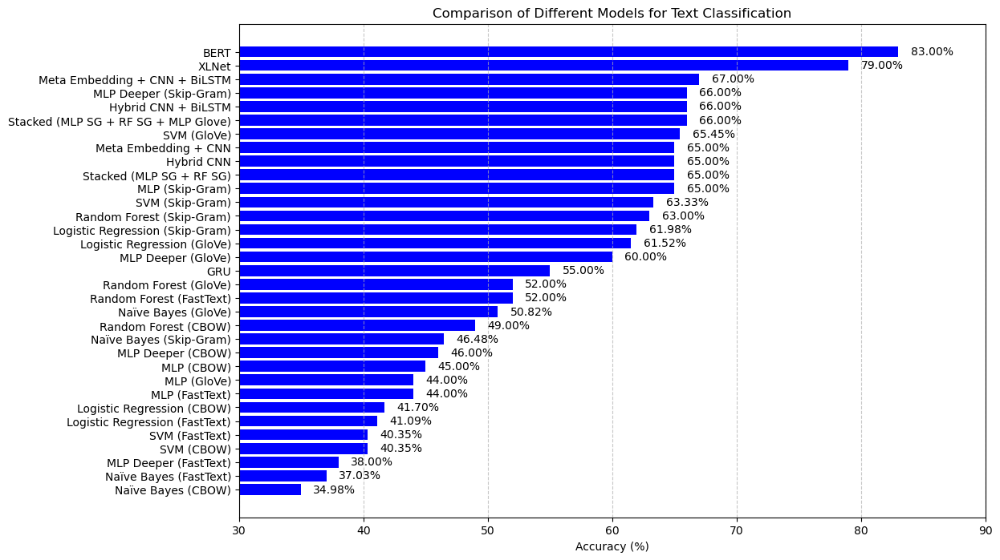

In [50]:
import matplotlib.pyplot as plt
import numpy as np

# Model names and their corresponding accuracies
models = [
    "Naïve Bayes (CBOW)", "Naïve Bayes (Skip-Gram)", "Naïve Bayes (GloVe)", "Naïve Bayes (FastText)",
    "SVM (CBOW)", "SVM (Skip-Gram)", "SVM (GloVe)", "SVM (FastText)",
    "Logistic Regression (CBOW)", "Logistic Regression (Skip-Gram)", "Logistic Regression (GloVe)", "Logistic Regression (FastText)",
    "MLP (CBOW)", "MLP (Skip-Gram)", "MLP (GloVe)", "MLP (FastText)",
    "MLP Deeper (CBOW)", "MLP Deeper (Skip-Gram)", "MLP Deeper (GloVe)", "MLP Deeper (FastText)",
    "Random Forest (CBOW)", "Random Forest (Skip-Gram)", "Random Forest (GloVe)", "Random Forest (FastText)",
    "Stacked (MLP SG + RF SG)", "Stacked (MLP SG + RF SG + MLP Glove)",
    "Hybrid CNN", "Hybrid CNN + BiLSTM",
    "Meta Embedding + CNN", "Meta Embedding + CNN + BiLSTM",
    "GRU", "BERT", "XLNet"
]

accuracies = [
    34.98, 46.48, 50.82, 37.03,  # Naïve Bayes
    40.35, 63.33, 65.45, 40.35,  # SVM
    41.70, 61.98, 61.52, 41.09,  # Logistic Regression
    45, 65, 44, 44,  # MLP
    46, 66, 60, 38,  # MLP Deeper
    49, 63, 52, 52,  # Random Forest
    65, 66,  # Stacked Models
    65, 66,  # Hybrid CNN
    65, 67,  # Meta Embedding
    55, 83, 79  # GRU, BERT, XLNet
]

# Sorting models by accuracy
sorted_indices = np.argsort(accuracies)[::-1]
sorted_models = [models[i] for i in sorted_indices]
sorted_accuracies = [accuracies[i] for i in sorted_indices]

# Plot
plt.figure(figsize=(12, 8))
bars = plt.barh(sorted_models, sorted_accuracies, color='blue')
plt.xlabel("Accuracy (%)")
plt.title("Comparison of Different Models for Text Classification")
plt.xlim(30, 90)  # Adjust range for better visualization
plt.gca().invert_yaxis()  # Highest accuracy on top
plt.grid(axis='x', linestyle='--', alpha=0.7)

# Add accuracy values at the end of bars
for bar, accuracy in zip(bars, sorted_accuracies):
    plt.text(bar.get_width() + 1, bar.get_y() + bar.get_height()/2, f"{accuracy:.2f}%", va='center', fontsize=10)

# Show plot
plt.show()
